In [ ]:
!pip install tflite-model-maker pycocotools

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
import numpy as np
import os

from tflite_model_maker.config import ExportFormat
from tflite_model_maker import model_spec
from tflite_model_maker import object_detector

import tensorflow as tf
assert tf.__version__.startswith('2')

tf.get_logger().setLevel('ERROR')
from absl import logging
logging.set_verbosity(logging.ERROR)

2021-08-18 19:56:07.239963: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0


In [3]:
tf.__version__

'2.5.0'

In [5]:
spec = model_spec.get('efficientdet_lite2')

2021-08-18 19:56:09.867988: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-18 19:56:09.868350: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1733] Found device 0 with properties: 
pciBusID: 0000:01:00.0 name: GeForce GTX 1050 computeCapability: 6.1
coreClock: 1.493GHz coreCount: 5 deviceMemorySize: 3.95GiB deviceMemoryBandwidth: 104.43GiB/s
2021-08-18 19:56:09.868498: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-18 19:56:09.868756: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-18 19:56:09.868954: I tensorflow/core/common_runtim

In [6]:
train_data, validation_data, test_data = object_detector.DataLoader.from_csv('../data/generated_data/positions.csv')

eamExecutor with strength 1 edge matrix:
2021-08-18 19:56:09.870305: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1264]      0 
2021-08-18 19:56:09.870309: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1277] 0:   N 
2021-08-18 19:56:09.870389: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-18 19:56:09.870637: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-08-18 19:56:09.870841: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1418] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 2874 MB memory) -> physical GPU (device: 0, name: GeForce GTX 1050, pci bus id: 0000:01:00.0, compute capability: 6.1)


In [8]:
model = object_detector.create(train_data, model_spec=spec, batch_size=4, train_whole_model=True, validation_data=validation_data, epochs=50)

Epoch 1/50
18/18 [==============================] - 42s 838ms/step - det_loss: 1.7917 - cls_loss: 1.1482 - box_loss: 0.0129 - reg_l2_loss: 0.0770 - loss: 1.8687 - learning_rate: 0.0065 - gradient_norm: 1.0300 - val_det_loss: 1.5169 - val_cls_loss: 1.1301 - val_box_loss: 0.0077 - val_reg_l2_loss: 0.0770 - val_loss: 1.5939
Epoch 2/50
18/18 [==============================] - 11s 596ms/step - det_loss: 1.5731 - cls_loss: 1.1279 - box_loss: 0.0089 - reg_l2_loss: 0.0770 - loss: 1.6500 - learning_rate: 0.0050 - gradient_norm: 1.5448 - val_det_loss: 1.3886 - val_cls_loss: 1.0985 - val_box_loss: 0.0058 - val_reg_l2_loss: 0.0770 - val_loss: 1.4655
Epoch 3/50
18/18 [==============================] - 11s 603ms/step - det_loss: 1.4396 - cls_loss: 1.0973 - box_loss: 0.0068 - reg_l2_loss: 0.0770 - loss: 1.5165 - learning_rate: 0.0050 - gradient_norm: 1.4676 - val_det_loss: 1.2839 - val_cls_loss: 1.0430 - val_box_loss: 0.0048 - val_reg_l2_loss: 0.0770 - val_loss: 1.3609
Epoch 4/50
18/18 [=============

In [9]:
model.evaluate(test_data)

2021-08-18 20:20:39.518565: W tensorflow/core/common_runtime/bfc_allocator.cc:271] Allocator (GPU_0_bfc) ran out of memory trying to allocate 854.51MiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.
2021-08-18 20:20:40.128452: W tensorflow/core/common_runtime/bfc_allocator.cc:271] Allocator (GPU_0_bfc) ran out of memory trying to allocate 1004.86MiB with freed_by_count=0. The caller indicates that this is not a failure, but may mean that there could be performance gains if more memory were available.


1/1 [==============================] - 5s 5s/step



{'AP': 0.44786352,
 'AP50': 0.55567604,
 'AP75': 0.52246404,
 'APs': -1.0,
 'APm': 0.5412948,
 'APl': 0.39974558,
 'ARmax1': 0.2835119,
 'ARmax10': 0.8112202,
 'ARmax100': 0.8122619,
 'ARs': -1.0,
 'ARm': 0.86703867,
 'ARl': 0.74553573,
 'AP_/1': 0.8716185,
 'AP_/0.5': 0.24040547,
 'AP_/0.02': 0.3113576,
 'AP_/0.05': 0.5330638,
 'AP_/0.2': 0.4605031,
 'AP_/0.01': 0.22444469,
 'AP_/0.1': 0.60738254,
 'AP_/2': 0.33413237}

In [10]:
model.export(export_dir='.')

2021-08-18 20:20:58.660187: W tensorflow/python/util/util.cc:348] Sets are not currently considered sequences, but this may change in the future, so consider avoiding using them.
2021-08-18 20:21:21.916236: W tensorflow/core/common_runtime/graph_constructor.cc:809] Node 'resample_p7/PartitionedCall' has 1 outputs but the _output_shapes attribute specifies shapes for 3 outputs. Output shapes may be inaccurate.
2021-08-18 20:21:33.690892: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:345] Ignored output_format.
2021-08-18 20:21:33.690929: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:348] Ignored drop_control_dependency.
2021-08-18 20:21:33.690934: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:354] Ignored change_concat_input_ranges.
2021-08-18 20:21:33.691838: I tensorflow/cc/saved_model/reader.cc:38] Reading SavedModel from: /tmp/tmpg6tyk_q1
2021-08-18 20:21:33.804041: I tensorflow/cc/saved_model/reader.cc:90] Reading me

In [11]:
model.evaluate_tflite('model.tflite', test_data)

8/8 [==============================] - 58s 7s/step



{'AP': 0.31149986,
 'AP50': 0.4058601,
 'AP75': 0.34784004,
 'APs': -1.0,
 'APm': 0.43884763,
 'APl': 0.23108381,
 'ARmax1': 0.23771825,
 'ARmax10': 0.39455357,
 'ARmax100': 0.39455357,
 'ARs': -1.0,
 'ARm': 0.5208333,
 'ARl': 0.31357142,
 'AP_/1': 0.8986386,
 'AP_/0.5': 0.07307148,
 'AP_/0.02': 0.2671287,
 'AP_/0.05': 0.3992282,
 'AP_/0.2': 0.26214522,
 'AP_/0.01': 0.06815182,
 'AP_/0.1': 0.20680313,
 'AP_/2': 0.31683168}

In [ ]:
# Test model

In [12]:
from PIL import Image, ImageDraw, ImageFont

model_path = 'model.tflite'

# Load the labels into a list
classes = ['???'] * model.model_spec.config.num_classes
label_map = model.model_spec.config.label_map
for label_id, label_name in label_map.as_dict().items():
    classes[label_id-1] = label_name

# Define a list of colors for visualization
COLORS = np.random.randint(0, 255, size=(len(classes), 3), dtype=np.uint8)

def preprocess_image(image_path, input_size):
    """Preprocess the input image to feed to the TFLite model"""
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.uint8)
    original_image = img
    resized_img = tf.image.resize(img, input_size)
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image


def set_input_tensor(interpreter, image):
    """Set the input tensor."""
    tensor_index = interpreter.get_input_details()[0]['index']
    input_tensor = interpreter.tensor(tensor_index)()[0]
    input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
    """Retur the output tensor at the given index."""
    output_details = interpreter.get_output_details()[index]
    tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
    return tensor


def detect_objects(interpreter, image, threshold):
    """Returns a list of detection results, each a dictionary of object info."""
    # Feed the input image to the model
    set_input_tensor(interpreter, image)
    interpreter.invoke()

    # Get all outputs from the model
    boxes = get_output_tensor(interpreter, 0)
    classes = get_output_tensor(interpreter, 1)
    scores = get_output_tensor(interpreter, 2)
    count = int(get_output_tensor(interpreter, 3))

    results = []
    for i in range(count):
        if scores[i] >= threshold:
            result = {
            'bounding_box': boxes[i],
            'class_id': classes[i],
            'score': scores[i]
            }
            results.append(result)
    return results


def run_odt_and_draw_results(image_path, interpreter, threshold=0.5, draw=True):
    """Run object detection on the input image and draw the detection results"""
    # Load the input shape required by the model
    _, input_height, input_width, _ = interpreter.get_input_details()[0]['shape']

    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(
      image_path,
      (input_height, input_width)
    )

    # Run object detection on the input image
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    
    # Plot the detection results on the input image
    original_image_np = original_image.numpy().astype(np.uint8)
    original_image_pil = Image.fromarray(original_image_np).copy()
    image_copy = Image.fromarray(original_image_np).copy()
    detected_coins = []
    for obj in results:
        # Convert the object bounding box from relative coordinates to absolute
        # coordinates based on the original image resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_image_np.shape[1])
        xmax = int(xmax * original_image_np.shape[1])
        ymin = int(ymin * original_image_np.shape[0])
        ymax = int(ymax * original_image_np.shape[0])

        # Find the class index of the current object
        class_id = int(obj['class_id'])

        # Draw the bounding box and label on the image
        if draw:
            color = [int(c) for c in COLORS[class_id]]
            fnt = ImageFont.truetype("Pillow/Tests/fonts/FreeMono.ttf", 15)
            draw = ImageDraw.Draw(image_copy)
            draw.rectangle((xmin, ymin, xmax, ymax), outline ="red")
            # Make adjustments to make the label visible for all objects
            y = ymin - 15 if ymin - 15 > 15 else ymin + 15
            label = "{}: {:.0f}%".format(classes[class_id], obj['score'] * 100)
            draw.text((xmin, ymin), label, font=fnt, fill="red")
            
        # cut the coins
        detected_coins.append(original_image_pil.crop((xmin, ymin, xmax, ymax)))

    return image_copy, results, detected_coins


In [13]:
data = pd.read_csv("../data/generated_data/positions.csv", header=None)
data.head()

,0,1,2,3,4,5,6,7,8,9,10
0,TRAIN,../data/generated_data/image_0.jpeg,1.00,0.117352,0.198333,NaN,NaN,0.356068,0.595000,NaN,NaN
1,TRAIN,../data/generated_data/image_0.jpeg,0.50,0.279840,0.581667,NaN,NaN,0.532598,0.995000,NaN,NaN
2,TRAIN,../data/generated_data/image_0.jpeg,1.00,0.472417,0.221667,NaN,NaN,0.711133,0.618333,NaN,NaN
3,TRAIN,../data/generated_data/image_0.jpeg,0.02,0.662989,0.105000,NaN,NaN,0.851555,0.418333,NaN,NaN
4,TRAIN,../data/generated_data/image_0.jpeg,0.05,0.002006,0.196667,NaN,NaN,0.218656,0.556667,NaN,NaN


array(['../data/generated_data/image_4.jpeg',
       '../data/generated_data/image_7.jpeg',
       '../data/generated_data/image_11.jpeg',
       '../data/generated_data/image_21.jpeg',
       '../data/generated_data/image_57.jpeg',
       '../data/generated_data/image_61.jpeg',
       '../data/generated_data/image_70.jpeg',
       '../data/generated_data/image_86.jpeg'], dtype=object)

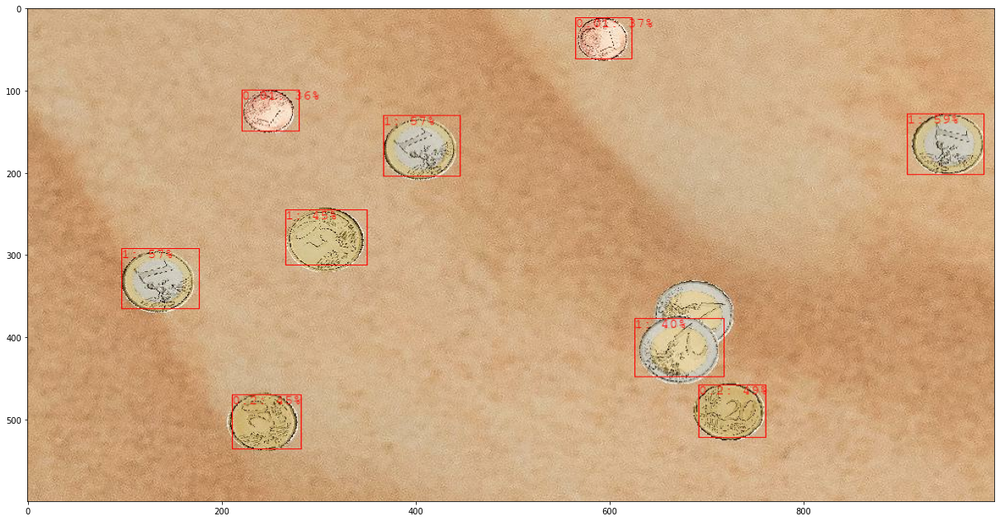

{'bounding_box': array([0.21384813, 0.9099988 , 0.33788896, 0.98970914], dtype=float32), 'class_id': 0.0, 'score': 0.59375}
1


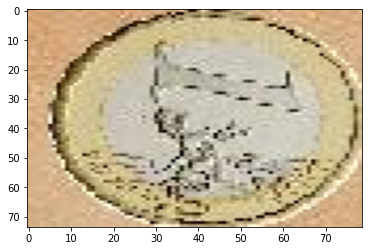

#########################
{'bounding_box': array([0.48712796, 0.09730998, 0.60852164, 0.17788479], dtype=float32), 'class_id': 0.0, 'score': 0.57421875}
1


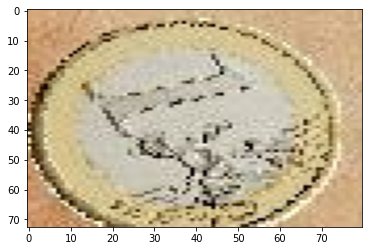

#########################
{'bounding_box': array([0.21769536, 0.36835092, 0.34040552, 0.44806135], dtype=float32), 'class_id': 0.0, 'score': 0.56640625}
1


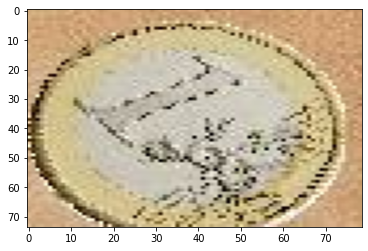

#########################
{'bounding_box': array([0.7648567 , 0.69408476, 0.87052023, 0.7640178 ], dtype=float32), 'class_id': 4.0, 'score': 0.4921875}
0.2


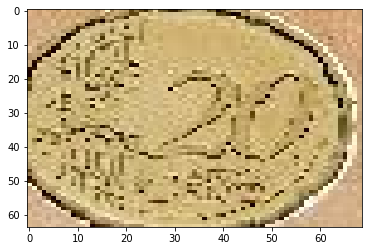

#########################
{'bounding_box': array([0.7848677 , 0.21182801, 0.8940062 , 0.28328604], dtype=float32), 'class_id': 4.0, 'score': 0.453125}
0.2


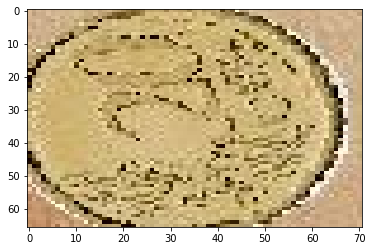

#########################
{'bounding_box': array([0.40947568, 0.26754734, 0.520142  , 0.35115156], dtype=float32), 'class_id': 0.0, 'score': 0.453125}
1


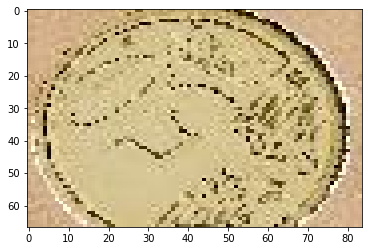

#########################
{'bounding_box': array([0.6286668 , 0.6285181 , 0.7480119 , 0.72064483], dtype=float32), 'class_id': 0.0, 'score': 0.3984375}
1


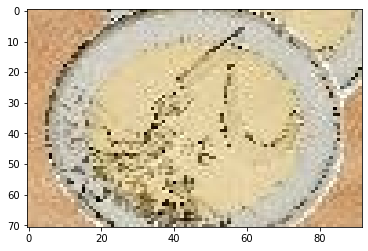

#########################
{'bounding_box': array([0.0190533 , 0.56691337, 0.10227789, 0.6258464 ], dtype=float32), 'class_id': 5.0, 'score': 0.3671875}
0.01


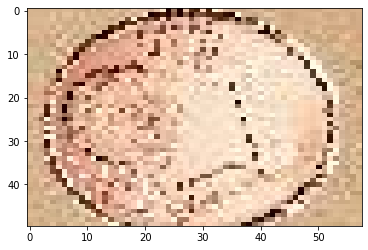

#########################
{'bounding_box': array([0.16557926, 0.22180484, 0.24880382, 0.28137702], dtype=float32), 'class_id': 5.0, 'score': 0.35546875}
0.01


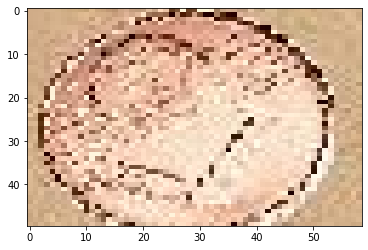

#########################


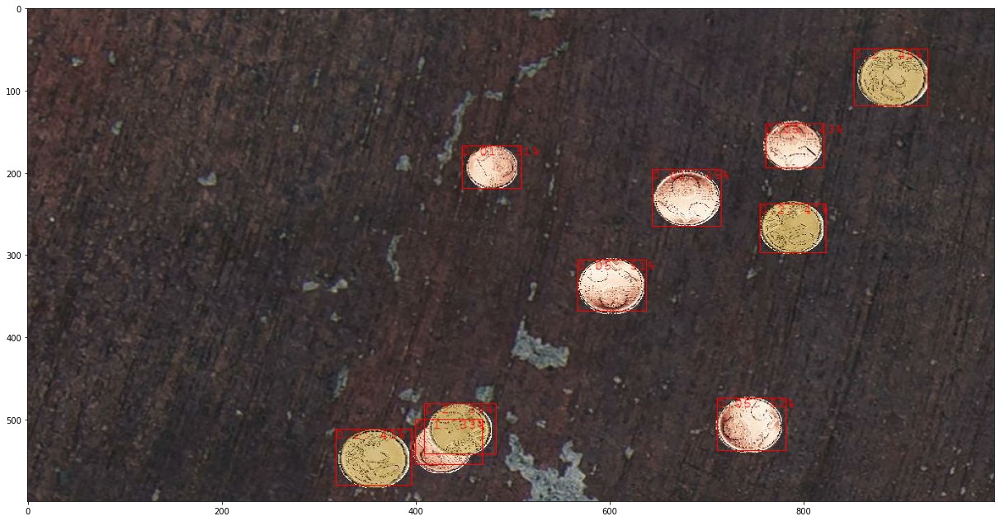

{'bounding_box': array([0.79149115, 0.7137737 , 0.8971547 , 0.7852317 ], dtype=float32), 'class_id': 3.0, 'score': 0.51953125}
0.05


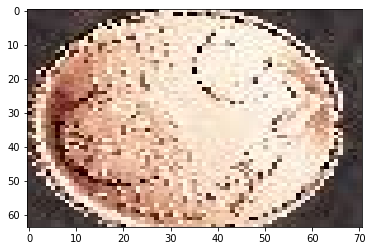

#########################
{'bounding_box': array([0.51023495, 0.5689708 , 0.61476505, 0.6404289 ], dtype=float32), 'class_id': 3.0, 'score': 0.5078125}
0.05


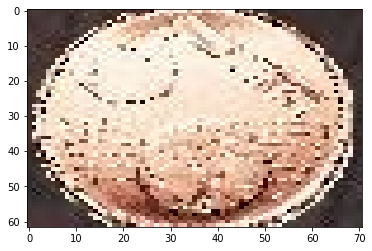

#########################
{'bounding_box': array([0.39811552, 0.7578283 , 0.49504417, 0.826269  ], dtype=float32), 'class_id': 4.0, 'score': 0.47265625}
0.2


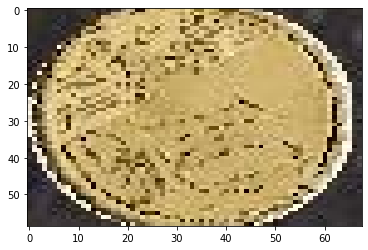

#########################
{'bounding_box': array([0.32795244, 0.6466004 , 0.44173914, 0.7173932 ], dtype=float32), 'class_id': 5.0, 'score': 0.453125}
0.01


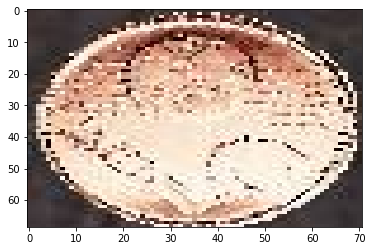

#########################
{'bounding_box': array([0.08189428, 0.8552368 , 0.198329  , 0.9314721 ], dtype=float32), 'class_id': 4.0, 'score': 0.4453125}
0.2


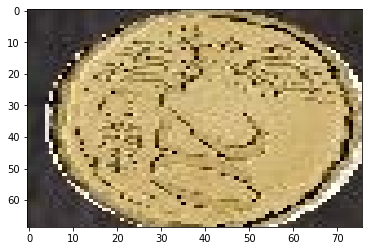

#########################
{'bounding_box': array([0.23395261, 0.7636023 , 0.32480732, 0.8243863 ], dtype=float32), 'class_id': 3.0, 'score': 0.43359375}
0.05


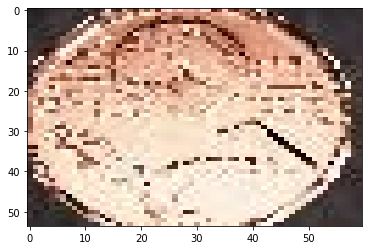

#########################
{'bounding_box': array([0.8541993, 0.3193399, 0.9669268, 0.3972375], dtype=float32), 'class_id': 4.0, 'score': 0.43359375}
0.2


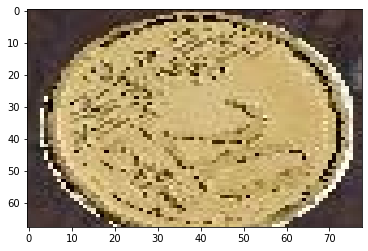

#########################
{'bounding_box': array([0.80225307, 0.41067043, 0.9045524 , 0.48447838], dtype=float32), 'class_id': 4.0, 'score': 0.38671875}
0.2


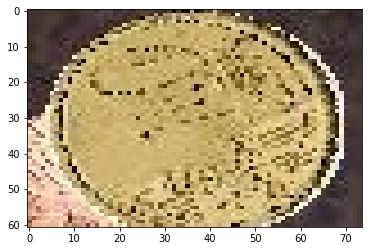

#########################
{'bounding_box': array([0.8336193 , 0.40198252, 0.9264551 , 0.47042325], dtype=float32), 'class_id': 6.0, 'score': 0.328125}
0.1


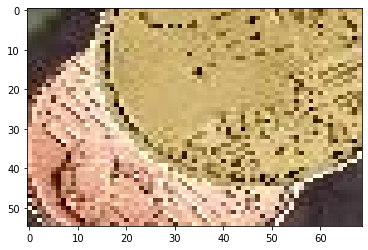

#########################
{'bounding_box': array([0.27912155, 0.44978625, 0.36508307, 0.5113175 ], dtype=float32), 'class_id': 5.0, 'score': 0.3125}
0.01


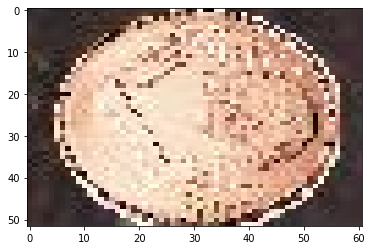

#########################


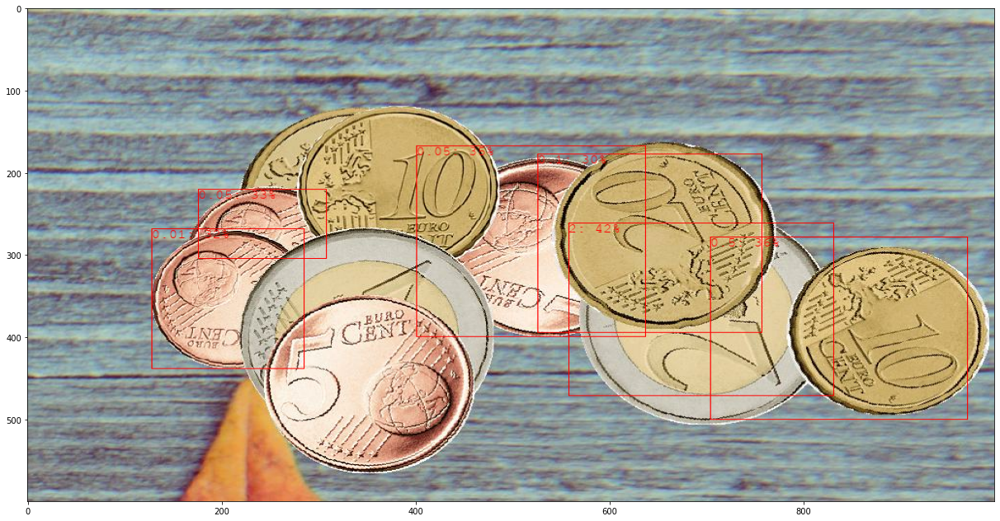

{'bounding_box': array([0.4351398 , 0.5598377 , 0.78648365, 0.8339933 ], dtype=float32), 'class_id': 7.0, 'score': 0.41796875}
2


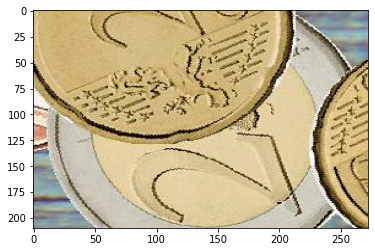

#########################
{'bounding_box': array([0.4638154 , 0.7070592 , 0.8346266 , 0.97248596], dtype=float32), 'class_id': 1.0, 'score': 0.35546875}
0.5


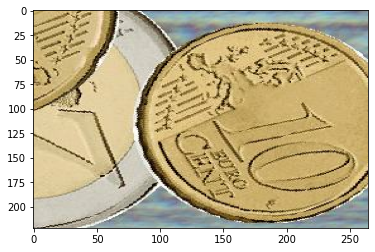

#########################
{'bounding_box': array([0.27954483, 0.40286753, 0.665499  , 0.6397344 ], dtype=float32), 'class_id': 3.0, 'score': 0.34765625}
0.05


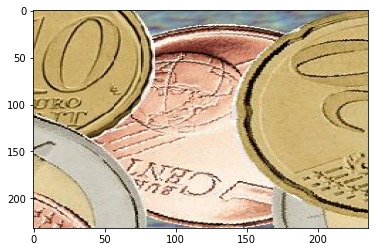

#########################
{'bounding_box': array([0.36722308, 0.17679259, 0.50729   , 0.309506  ], dtype=float32), 'class_id': 3.0, 'score': 0.328125}
0.05


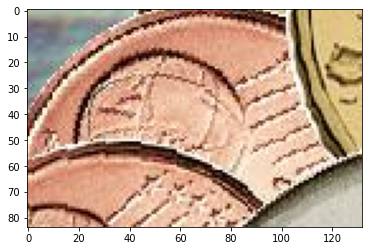

#########################
{'bounding_box': array([0.4481054 , 0.12857968, 0.73046607, 0.28629032], dtype=float32), 'class_id': 5.0, 'score': 0.31640625}
0.01


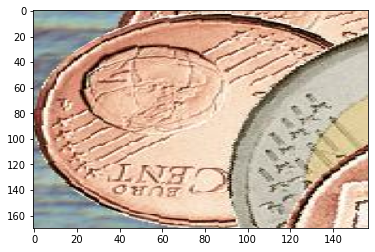

#########################
{'bounding_box': array([0.29575568, 0.52766156, 0.6575243 , 0.7594737 ], dtype=float32), 'class_id': 6.0, 'score': 0.30078125}
0.1


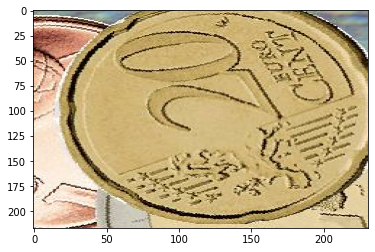

#########################


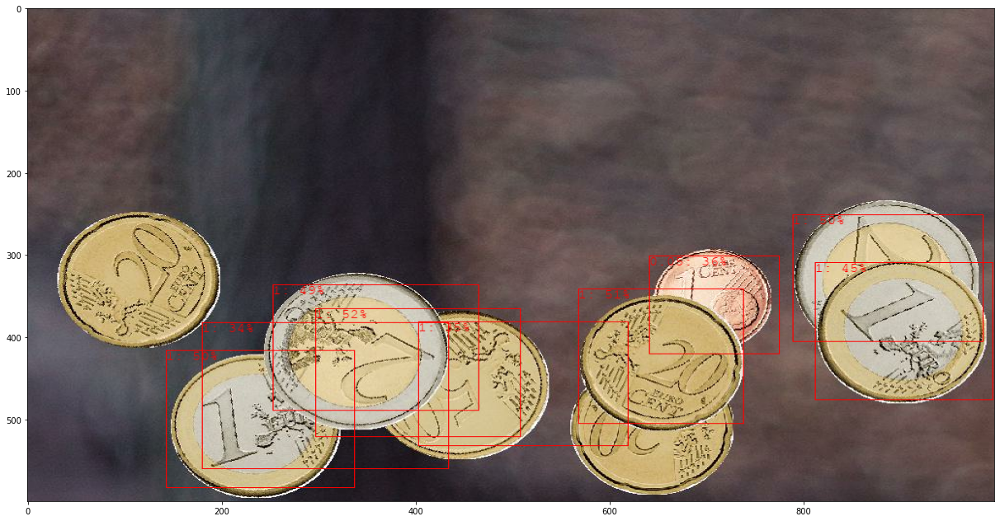

{'bounding_box': array([0.60834384, 0.2984197 , 0.8685441 , 0.5104066 ], dtype=float32), 'class_id': 0.0, 'score': 0.51953125}
1


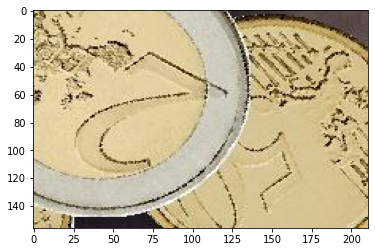

#########################
{'bounding_box': array([0.569319  , 0.5706083 , 0.84308183, 0.7404433 ], dtype=float32), 'class_id': 0.0, 'score': 0.51171875}
1


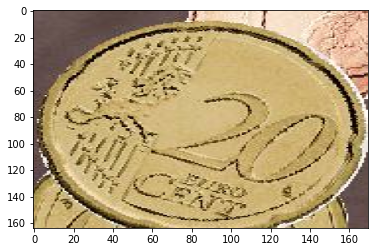

#########################
{'bounding_box': array([0.6936455 , 0.14358938, 0.9725071 , 0.338939  ], dtype=float32), 'class_id': 0.0, 'score': 0.5}
1


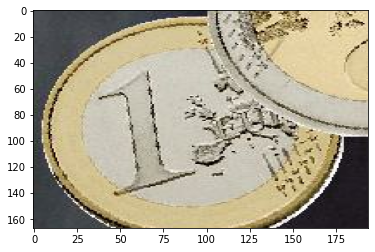

#########################
{'bounding_box': array([0.41856587, 0.7922602 , 0.6759747 , 0.9888316 ], dtype=float32), 'class_id': 0.0, 'score': 0.5}
1


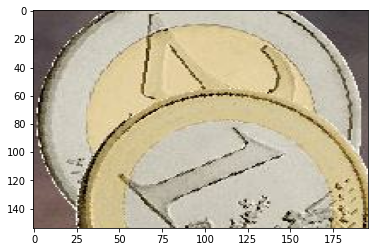

#########################
{'bounding_box': array([0.5604926 , 0.25472558, 0.81513995, 0.46671247], dtype=float32), 'class_id': 0.0, 'score': 0.48828125}
1


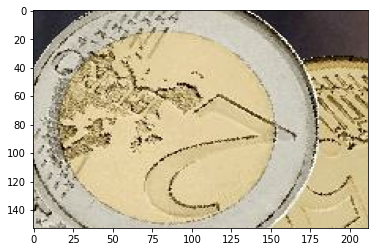

#########################
{'bounding_box': array([0.51554525, 0.8153371 , 0.7948768 , 0.99875385], dtype=float32), 'class_id': 0.0, 'score': 0.4453125}
1


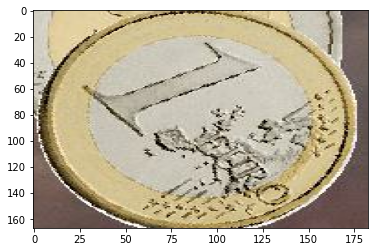

#########################
{'bounding_box': array([0.50321466, 0.6437167 , 0.70129913, 0.77767694], dtype=float32), 'class_id': 3.0, 'score': 0.35546875}
0.05


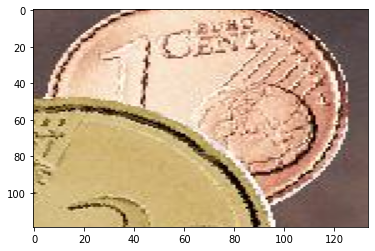

#########################
{'bounding_box': array([0.6355982 , 0.4042975 , 0.8875139 , 0.62090695], dtype=float32), 'class_id': 0.0, 'score': 0.34765625}
1


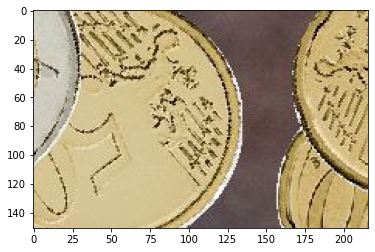

#########################
{'bounding_box': array([0.63827944, 0.18152992, 0.9343593 , 0.4353848 ], dtype=float32), 'class_id': 0.0, 'score': 0.34375}
1


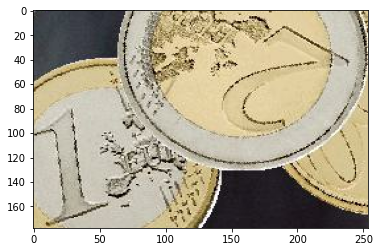

#########################


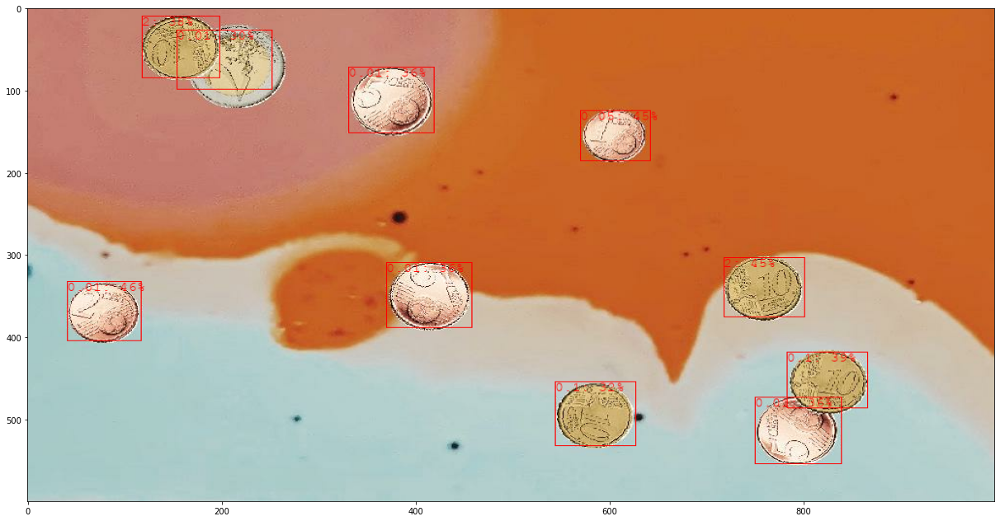

{'bounding_box': array([0.55419135, 0.04126761, 0.6742828 , 0.11761226], dtype=float32), 'class_id': 5.0, 'score': 0.4609375}
0.01


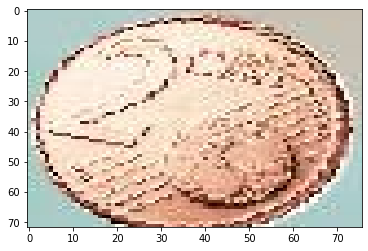

#########################
{'bounding_box': array([0.50520587, 0.72098505, 0.6252973 , 0.8042096 ], dtype=float32), 'class_id': 7.0, 'score': 0.4453125}
2


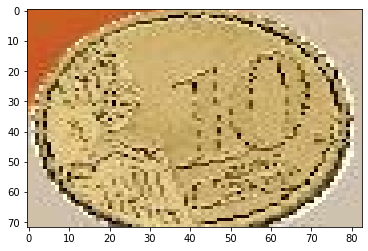

#########################
{'bounding_box': array([0.2083276 , 0.5724747 , 0.30952954, 0.6447077 ], dtype=float32), 'class_id': 3.0, 'score': 0.4453125}
0.05


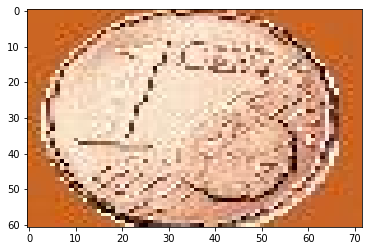

#########################
{'bounding_box': array([0.6967651, 0.7855617, 0.810715 , 0.868667 ], dtype=float32), 'class_id': 6.0, 'score': 0.38671875}
0.1


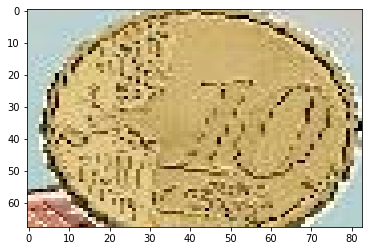

#########################
{'bounding_box': array([0.01582979, 0.11883593, 0.1412157 , 0.19941074], dtype=float32), 'class_id': 7.0, 'score': 0.375}
2


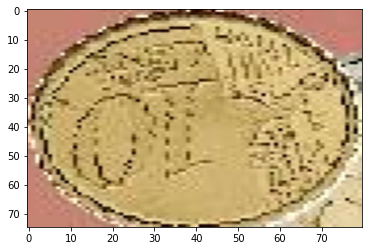

#########################
{'bounding_box': array([0.78928995, 0.75300026, 0.9245089 , 0.84178865], dtype=float32), 'class_id': 5.0, 'score': 0.35546875}
0.01


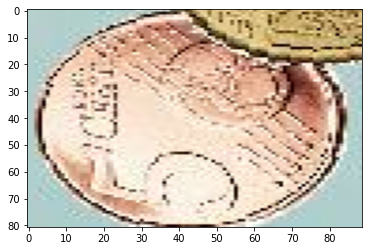

#########################
{'bounding_box': array([0.5158174 , 0.37205607, 0.64673114, 0.45989203], dtype=float32), 'class_id': 5.0, 'score': 0.35546875}
0.01


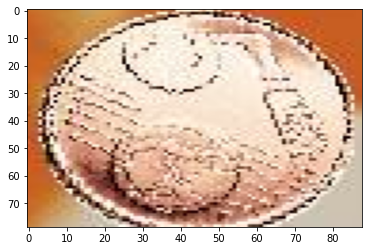

#########################
{'bounding_box': array([0.1194989 , 0.332673  , 0.25183228, 0.42050898], dtype=float32), 'class_id': 5.0, 'score': 0.35546875}
0.01


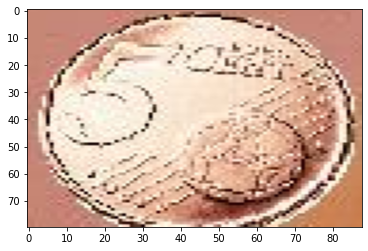

#########################
{'bounding_box': array([0.7573477 , 0.54608244, 0.8868569 , 0.629307  ], dtype=float32), 'class_id': 6.0, 'score': 0.32421875}
0.1


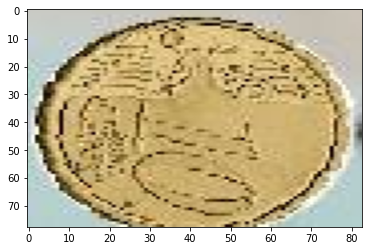

#########################
{'bounding_box': array([0.0439889 , 0.15537496, 0.16462818, 0.25366062], dtype=float32), 'class_id': 5.0, 'score': 0.3046875}
0.01


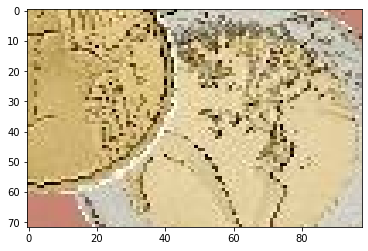

#########################


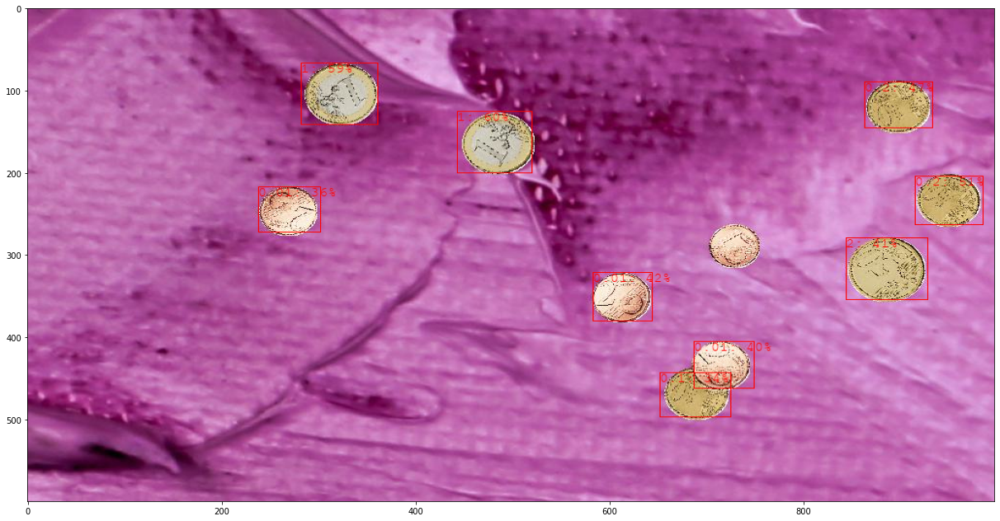

{'bounding_box': array([0.20950677, 0.44514754, 0.3348927 , 0.5223201 ], dtype=float32), 'class_id': 0.0, 'score': 0.6015625}
1


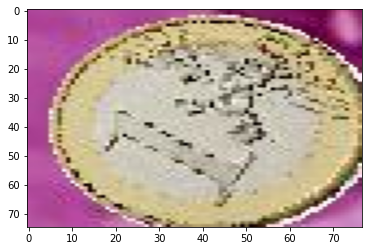

#########################
{'bounding_box': array([0.11129128, 0.28316432, 0.23533207, 0.36287475], dtype=float32), 'class_id': 0.0, 'score': 0.5859375}
1


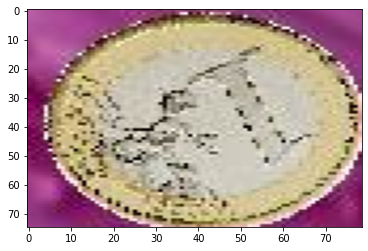

#########################
{'bounding_box': array([0.34142432, 0.9180657 , 0.43940404, 0.9887572 ], dtype=float32), 'class_id': 4.0, 'score': 0.5078125}
0.2


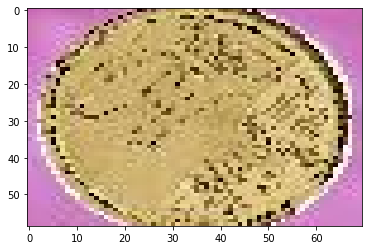

#########################
{'bounding_box': array([0.1498594 , 0.86617064, 0.24269524, 0.9361037 ], dtype=float32), 'class_id': 4.0, 'score': 0.47265625}
0.2


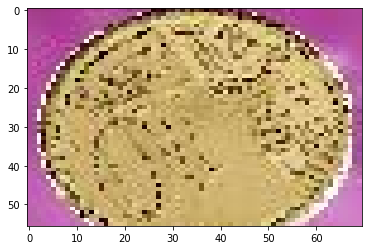

#########################
{'bounding_box': array([0.5360234 , 0.5856359 , 0.63386273, 0.646507  ], dtype=float32), 'class_id': 5.0, 'score': 0.41796875}
0.01


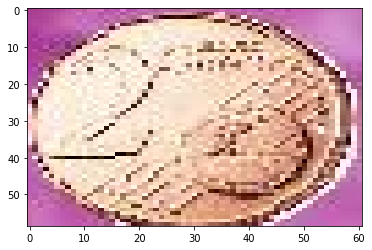

#########################
{'bounding_box': array([0.46592718, 0.84736824, 0.59131306, 0.9314953 ], dtype=float32), 'class_id': 7.0, 'score': 0.40625}
2


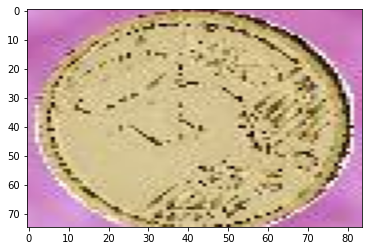

#########################
{'bounding_box': array([0.67533857, 0.6893635 , 0.77109   , 0.7515619 ], dtype=float32), 'class_id': 5.0, 'score': 0.3984375}
0.01


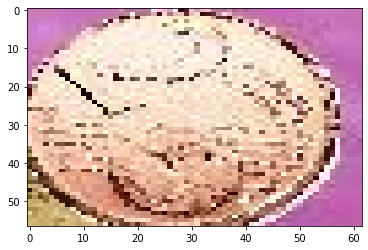

#########################
{'bounding_box': array([0.36284387, 0.23881221, 0.4535684 , 0.30375284], dtype=float32), 'class_id': 5.0, 'score': 0.35546875}
0.01


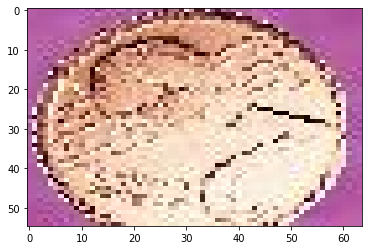

#########################
{'bounding_box': array([0.73856676, 0.6543508 , 0.82887936, 0.72792906], dtype=float32), 'class_id': 6.0, 'score': 0.3359375}
0.1


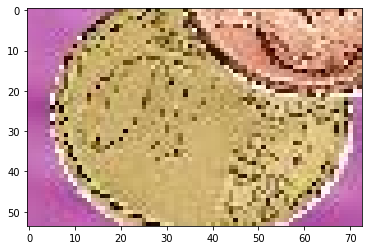

#########################


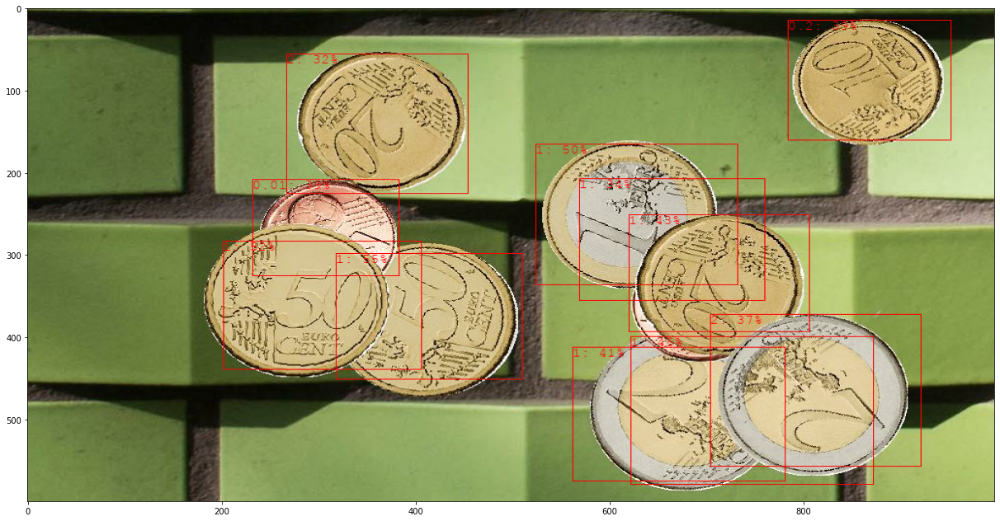

{'bounding_box': array([0.49830878, 0.31978098, 0.7529563 , 0.5121574 ], dtype=float32), 'class_id': 0.0, 'score': 0.546875}
1


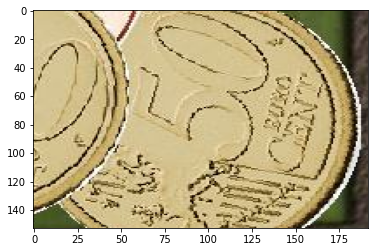

#########################
{'bounding_box': array([0.47242033, 0.20263138, 0.7326206 , 0.4078689 ], dtype=float32), 'class_id': 0.0, 'score': 0.51953125}
1


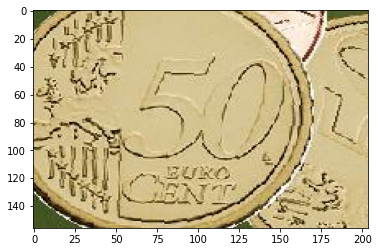

#########################
{'bounding_box': array([0.27659333, 0.5262336 , 0.5615358 , 0.73464304], dtype=float32), 'class_id': 0.0, 'score': 0.5}
1


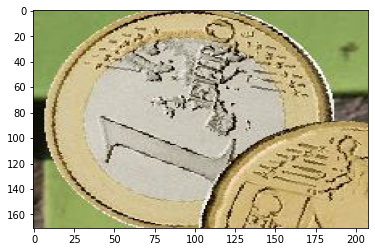

#########################
{'bounding_box': array([0.66523933, 0.624825  , 0.96597004, 0.875175  ], dtype=float32), 'class_id': 0.0, 'score': 0.4453125}
1


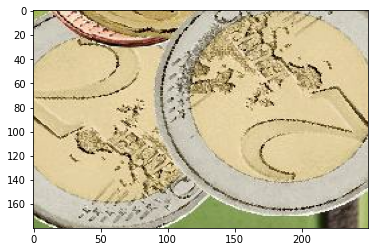

#########################
{'bounding_box': array([0.4199607 , 0.6224251 , 0.65609026, 0.80867636], dtype=float32), 'class_id': 0.0, 'score': 0.42578125}
1


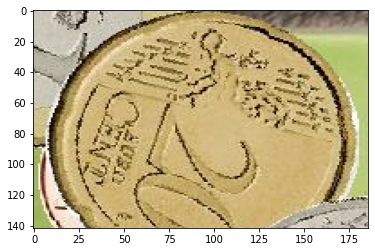

#########################
{'bounding_box': array([0.687904  , 0.56446993, 0.95957553, 0.7834282 ], dtype=float32), 'class_id': 0.0, 'score': 0.4140625}
1


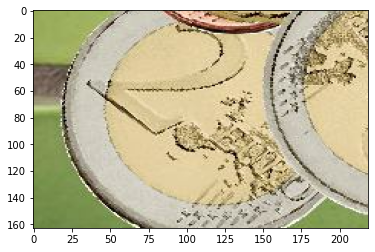

#########################
{'bounding_box': array([0.3467548 , 0.233549  , 0.54243356, 0.38460028], dtype=float32), 'class_id': 5.0, 'score': 0.38671875}
0.01


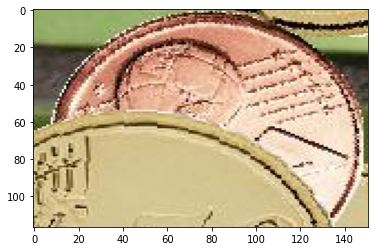

#########################
{'bounding_box': array([0.02358092, 0.7871021 , 0.26671678, 0.9551152 ], dtype=float32), 'class_id': 4.0, 'score': 0.38671875}
0.2


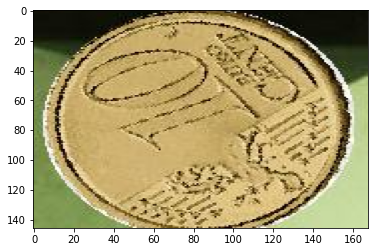

#########################
{'bounding_box': array([0.62119347, 0.706806  , 0.92848176, 0.92440337], dtype=float32), 'class_id': 7.0, 'score': 0.3671875}
2


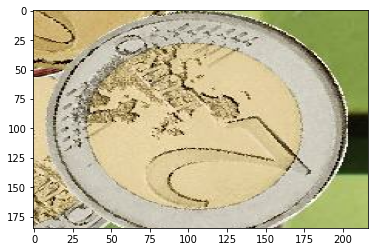

#########################
{'bounding_box': array([0.34563825, 0.57082725, 0.592178  , 0.7632036 ], dtype=float32), 'class_id': 0.0, 'score': 0.3359375}
1


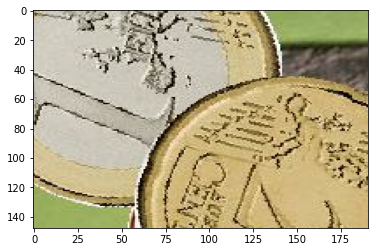

#########################
{'bounding_box': array([0.09279694, 0.26845106, 0.3751576 , 0.45586726], dtype=float32), 'class_id': 7.0, 'score': 0.32421875}
2


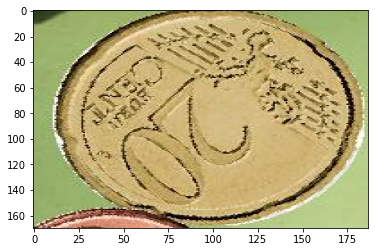

#########################


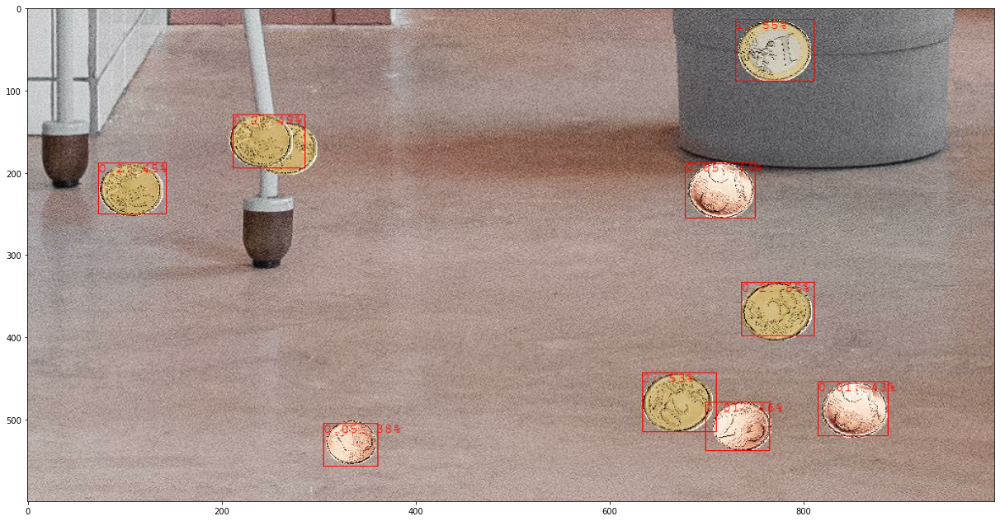

{'bounding_box': array([0.5556021 , 0.73883295, 0.6635697 , 0.8134414 ], dtype=float32), 'class_id': 4.0, 'score': 0.546875}
0.2


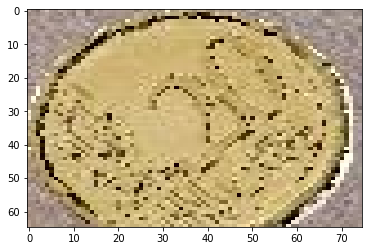

#########################
{'bounding_box': array([0.0222502 , 0.7323927 , 0.14763612, 0.81384116], dtype=float32), 'class_id': 0.0, 'score': 0.546875}
1


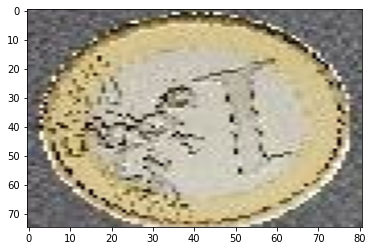

#########################
{'bounding_box': array([0.73982733, 0.63605654, 0.85863036, 0.71240115], dtype=float32), 'class_id': 7.0, 'score': 0.52734375}
2


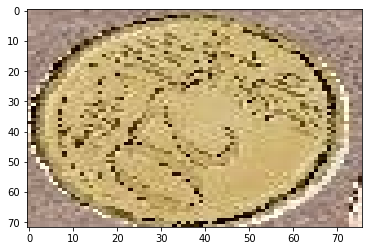

#########################
{'bounding_box': array([0.21661884, 0.21324727, 0.32458645, 0.28705528], dtype=float32), 'class_id': 4.0, 'score': 0.48828125}
0.2


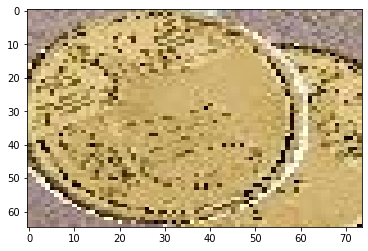

#########################
{'bounding_box': array([0.79876417, 0.7018286 , 0.89766437, 0.76747346], dtype=float32), 'class_id': 5.0, 'score': 0.46484375}
0.01


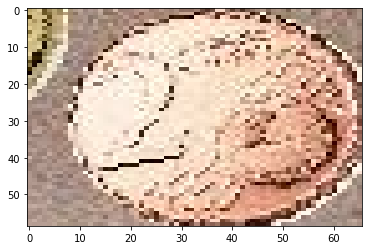

#########################
{'bounding_box': array([0.31492174, 0.07397074, 0.41722107, 0.14390382], dtype=float32), 'class_id': 4.0, 'score': 0.4453125}
0.2


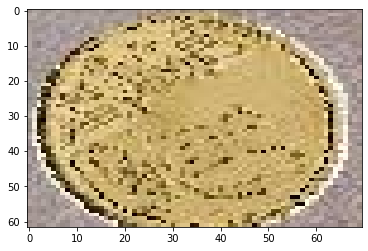

#########################
{'bounding_box': array([0.31192967, 0.68062556, 0.42571637, 0.7529621 ], dtype=float32), 'class_id': 3.0, 'score': 0.4375}
0.05


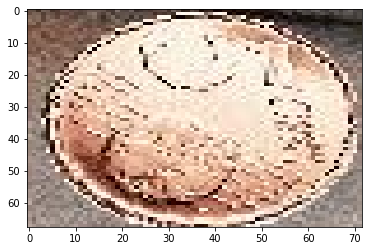

#########################
{'bounding_box': array([0.75741816, 0.8179796 , 0.86758184, 0.8903161 ], dtype=float32), 'class_id': 5.0, 'score': 0.43359375}
0.01


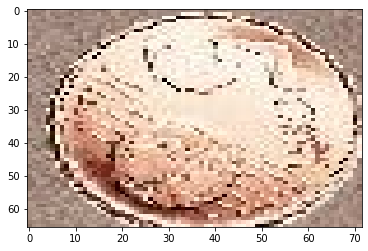

#########################
{'bounding_box': array([0.84171647, 0.3060666 , 0.92873484, 0.36243036], dtype=float32), 'class_id': 3.0, 'score': 0.375}
0.05


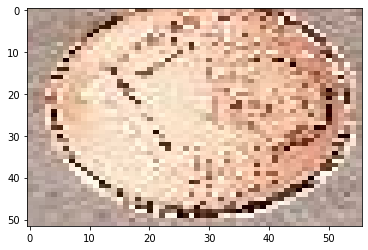

#########################


In [28]:
DETECTION_THRESHOLD = 0.3

# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path=model_path)
interpreter.allocate_tensors()

for test_file in data[data[0]=='TEST'][1].unique():
    # Run inference and draw detection result on the local copy of the original file
    detection_result_image, results, detected_coins = run_odt_and_draw_results(
        test_file,
        interpreter,
        threshold=DETECTION_THRESHOLD,
        draw=True
    )
    # Show the detection result
    plt.figure(figsize = (21,11))
    plt.imshow(np.asarray(detection_result_image), aspect="auto")
    detection_result_image
    plt.show()
    
    for res, img in zip(results, detected_coins):
        print(res)
        print(classes[int(res["class_id"])])
        plt.imshow(np.asarray(img), aspect="auto")
        plt.show()
        print("#"*25)


# Train using just coin as a label

In [33]:
data = pd.read_csv('../data/generated_data/positions.csv', header=None)
data[2] = "coin"
data.to_csv('../data/generated_data/positions_coin.csv', header=None, index=False)

In [34]:
spec = model_spec.get('efficientdet_lite2')

In [35]:
train_data, validation_data, test_data = object_detector.DataLoader.from_csv('../data/generated_data/positions_coin.csv')

In [36]:
model = object_detector.create(train_data, model_spec=spec, batch_size=4, train_whole_model=True, validation_data=validation_data, epochs=50)

Epoch 1/50
18/18 [==============================] - 41s 840ms/step - det_loss: 1.6938 - cls_loss: 1.0846 - box_loss: 0.0122 - reg_l2_loss: 0.0759 - loss: 1.7696 - learning_rate: 0.0065 - gradient_norm: 1.5086 - val_det_loss: 1.3351 - val_cls_loss: 0.9549 - val_box_loss: 0.0076 - val_reg_l2_loss: 0.0759 - val_loss: 1.4110
Epoch 2/50
18/18 [==============================] - 11s 601ms/step - det_loss: 1.2009 - cls_loss: 0.7921 - box_loss: 0.0082 - reg_l2_loss: 0.0759 - loss: 1.2768 - learning_rate: 0.0050 - gradient_norm: 2.1226 - val_det_loss: 0.9876 - val_cls_loss: 0.7335 - val_box_loss: 0.0051 - val_reg_l2_loss: 0.0759 - val_loss: 1.0635
Epoch 3/50
18/18 [==============================] - 11s 609ms/step - det_loss: 0.8859 - cls_loss: 0.5356 - box_loss: 0.0070 - reg_l2_loss: 0.0759 - loss: 0.9618 - learning_rate: 0.0050 - gradient_norm: 2.7674 - val_det_loss: 0.5182 - val_cls_loss: 0.3313 - val_box_loss: 0.0037 - val_reg_l2_loss: 0.0759 - val_loss: 0.5941
Epoch 4/50
18/18 [=============

In [37]:
model.evaluate(test_data)

1/1 [==============================] - 3s 3s/step



{'AP': 0.83676493,
 'AP50': 0.97979885,
 'AP75': 0.9426109,
 'APs': -1.0,
 'APm': 0.89694214,
 'APl': 0.7380113,
 'ARmax1': 0.09125,
 'ARmax10': 0.84,
 'ARmax100': 0.89125,
 'ARs': -1.0,
 'ARm': 0.9346939,
 'ARl': 0.82258064,
 'AP_/coin': 0.83676493}

In [38]:
model.export(export_dir='.')

2021-08-18 20:54:16.417400: W tensorflow/core/common_runtime/graph_constructor.cc:809] Node 'resample_p7/PartitionedCall' has 1 outputs but the _output_shapes attribute specifies shapes for 3 outputs. Output shapes may be inaccurate.
2021-08-18 20:54:25.410323: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:345] Ignored output_format.
2021-08-18 20:54:25.410351: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:348] Ignored drop_control_dependency.
2021-08-18 20:54:25.410360: W tensorflow/compiler/mlir/lite/python/tf_tfl_flatbuffer_helpers.cc:354] Ignored change_concat_input_ranges.
2021-08-18 20:54:25.410587: I tensorflow/cc/saved_model/reader.cc:38] Reading SavedModel from: /tmp/tmpd9ihs9hr
2021-08-18 20:54:25.551159: I tensorflow/cc/saved_model/reader.cc:90] Reading meta graph with tags { serve }
2021-08-18 20:54:25.551192: I tensorflow/cc/saved_model/reader.cc:132] Reading SavedModel debug info (if present) from: /tmp/tmpd9ihs9hr
2021-08-18 20

In [39]:
model.evaluate_tflite('model.tflite', test_data)

8/8 [==============================] - 58s 7s/step



{'AP': 0.80979234,
 'AP50': 0.9638424,
 'AP75': 0.9272293,
 'APs': -1.0,
 'APm': 0.8792772,
 'APl': 0.7040927,
 'ARmax1': 0.0875,
 'ARmax10': 0.84,
 'ARmax100': 0.84625,
 'ARs': -1.0,
 'ARm': 0.90408164,
 'ARl': 0.7548387,
 'AP_/coin': 0.80979234}

In [40]:
# Test model

In [41]:
from PIL import Image, ImageDraw, ImageFont

model_path = 'model.tflite'

# Load the labels into a list
classes = ['???'] * model.model_spec.config.num_classes
label_map = model.model_spec.config.label_map
for label_id, label_name in label_map.as_dict().items():
    classes[label_id-1] = label_name

# Define a list of colors for visualization
COLORS = np.random.randint(0, 255, size=(len(classes), 3), dtype=np.uint8)

def preprocess_image(image_path, input_size):
    """Preprocess the input image to feed to the TFLite model"""
    img = tf.io.read_file(image_path)
    img = tf.io.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.uint8)
    original_image = img
    resized_img = tf.image.resize(img, input_size)
    resized_img = resized_img[tf.newaxis, :]
    return resized_img, original_image


def set_input_tensor(interpreter, image):
    """Set the input tensor."""
    tensor_index = interpreter.get_input_details()[0]['index']
    input_tensor = interpreter.tensor(tensor_index)()[0]
    input_tensor[:, :] = image


def get_output_tensor(interpreter, index):
    """Retur the output tensor at the given index."""
    output_details = interpreter.get_output_details()[index]
    tensor = np.squeeze(interpreter.get_tensor(output_details['index']))
    return tensor


def detect_objects(interpreter, image, threshold):
    """Returns a list of detection results, each a dictionary of object info."""
    # Feed the input image to the model
    set_input_tensor(interpreter, image)
    interpreter.invoke()

    # Get all outputs from the model
    boxes = get_output_tensor(interpreter, 0)
    classes = get_output_tensor(interpreter, 1)
    scores = get_output_tensor(interpreter, 2)
    count = int(get_output_tensor(interpreter, 3))

    results = []
    for i in range(count):
        if scores[i] >= threshold:
            result = {
            'bounding_box': boxes[i],
            'class_id': classes[i],
            'score': scores[i]
            }
            results.append(result)
    return results


def run_odt_and_draw_results(image_path, interpreter, threshold=0.5, draw=True):
    """Run object detection on the input image and draw the detection results"""
    # Load the input shape required by the model
    _, input_height, input_width, _ = interpreter.get_input_details()[0]['shape']

    # Load the input image and preprocess it
    preprocessed_image, original_image = preprocess_image(
      image_path,
      (input_height, input_width)
    )

    # Run object detection on the input image
    results = detect_objects(interpreter, preprocessed_image, threshold=threshold)
    
    # Plot the detection results on the input image
    original_image_np = original_image.numpy().astype(np.uint8)
    original_image_pil = Image.fromarray(original_image_np).copy()
    image_copy = Image.fromarray(original_image_np).copy()
    detected_coins = []
    for obj in results:
        # Convert the object bounding box from relative coordinates to absolute
        # coordinates based on the original image resolution
        ymin, xmin, ymax, xmax = obj['bounding_box']
        xmin = int(xmin * original_image_np.shape[1])
        xmax = int(xmax * original_image_np.shape[1])
        ymin = int(ymin * original_image_np.shape[0])
        ymax = int(ymax * original_image_np.shape[0])

        # Find the class index of the current object
        class_id = int(obj['class_id'])

        # Draw the bounding box and label on the image
        if draw:
            color = [int(c) for c in COLORS[class_id]]
            fnt = ImageFont.truetype("Pillow/Tests/fonts/FreeMono.ttf", 15)
            draw = ImageDraw.Draw(image_copy)
            draw.rectangle((xmin, ymin, xmax, ymax), outline ="red")
            # Make adjustments to make the label visible for all objects
            y = ymin - 15 if ymin - 15 > 15 else ymin + 15
            label = "{}: {:.0f}%".format(classes[class_id], obj['score'] * 100)
            draw.text((xmin, ymin), label, font=fnt, fill="red")
            
        # cut the coins
        detected_coins.append(original_image_pil.crop((xmin, ymin, xmax, ymax)))

    return image_copy, results, detected_coins


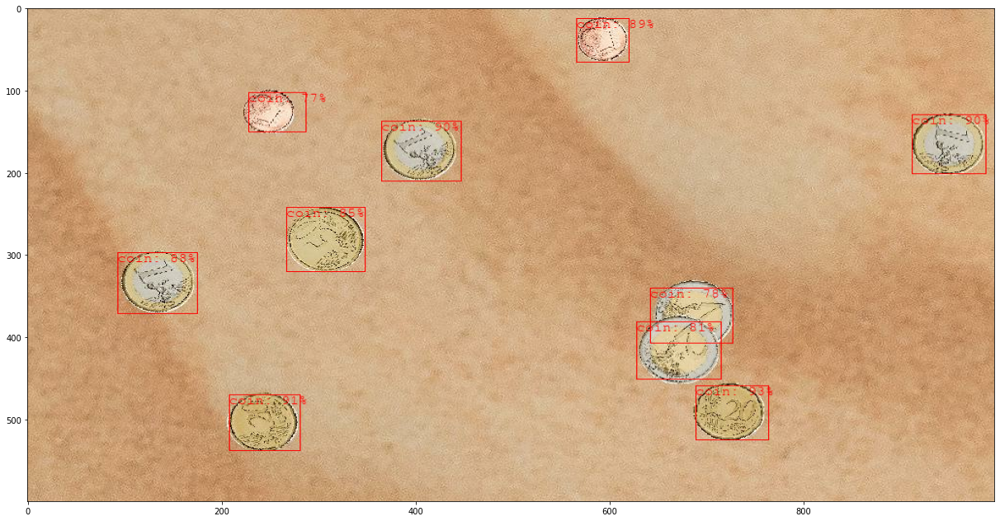

{'bounding_box': array([0.7652137 , 0.69204545, 0.87595654, 0.7669599 ], dtype=float32), 'class_id': 0.0, 'score': 0.9296875}
coin


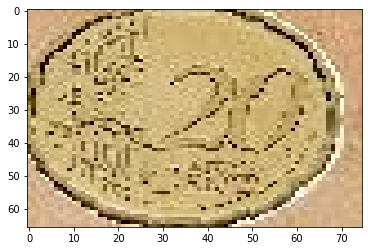

#########################
{'bounding_box': array([0.7834826 , 0.20876914, 0.897559  , 0.2822669 ], dtype=float32), 'class_id': 0.0, 'score': 0.91015625}
coin


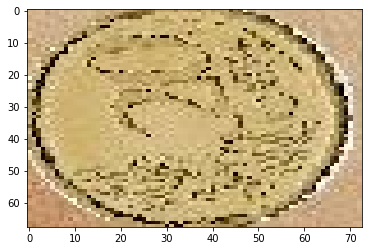

#########################
{'bounding_box': array([0.2284683 , 0.3668809 , 0.35025692, 0.44926745], dtype=float32), 'class_id': 0.0, 'score': 0.8984375}
coin


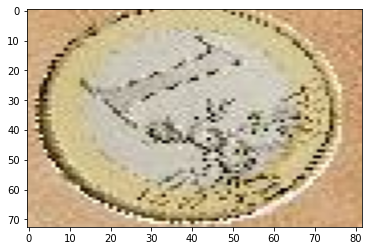

#########################
{'bounding_box': array([0.21626613, 0.9153034 , 0.3355086 , 0.9918174 ], dtype=float32), 'class_id': 0.0, 'score': 0.8984375}
coin


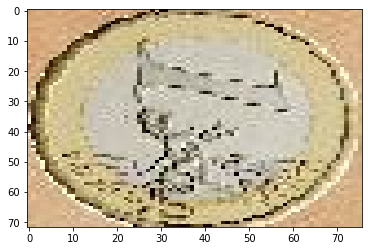

#########################
{'bounding_box': array([0.02065771, 0.56838524, 0.10837572, 0.62199306], dtype=float32), 'class_id': 0.0, 'score': 0.88671875}
coin


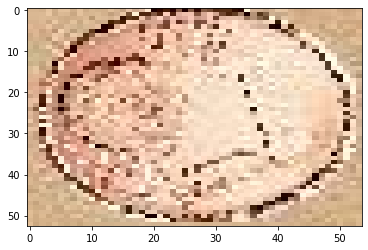

#########################
{'bounding_box': array([0.4956787 , 0.09406651, 0.61876065, 0.17558733], dtype=float32), 'class_id': 0.0, 'score': 0.875}
coin


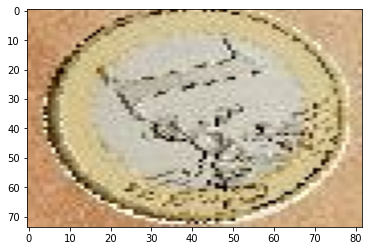

#########################
{'bounding_box': array([0.40474194, 0.26857454, 0.5344998 , 0.3492387 ], dtype=float32), 'class_id': 0.0, 'score': 0.8515625}
coin


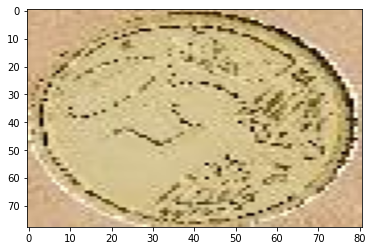

#########################
{'bounding_box': array([0.6352501 , 0.6304672 , 0.75307953, 0.7181257 ], dtype=float32), 'class_id': 0.0, 'score': 0.8125}
coin


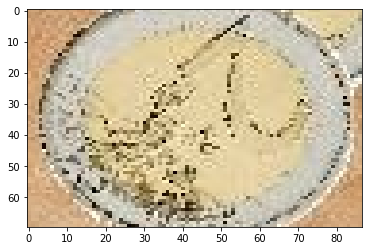

#########################
{'bounding_box': array([0.5679846 , 0.64491177, 0.67975175, 0.72983575], dtype=float32), 'class_id': 0.0, 'score': 0.77734375}
coin


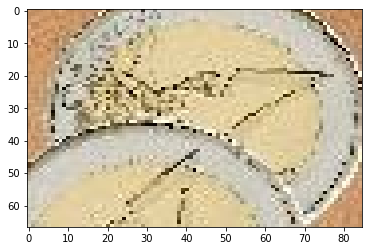

#########################
{'bounding_box': array([0.17151879, 0.22916709, 0.2506038 , 0.28862673], dtype=float32), 'class_id': 0.0, 'score': 0.76953125}
coin


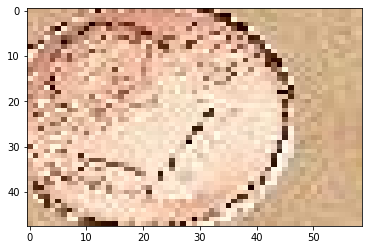

#########################


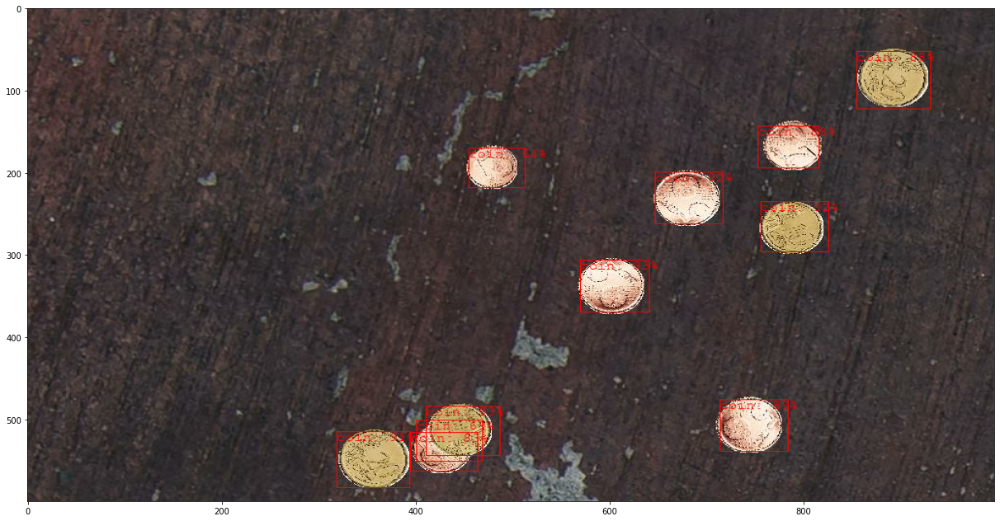

{'bounding_box': array([0.8081659 , 0.41271818, 0.90780675, 0.48923224], dtype=float32), 'class_id': 0.0, 'score': 0.9296875}
coin


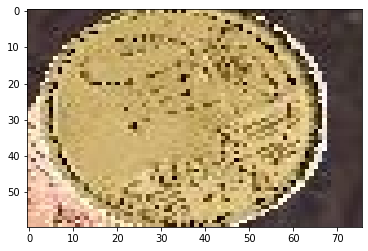

#########################
{'bounding_box': array([0.5103179 , 0.572566  , 0.6164788 , 0.64362615], dtype=float32), 'class_id': 0.0, 'score': 0.92578125}
coin


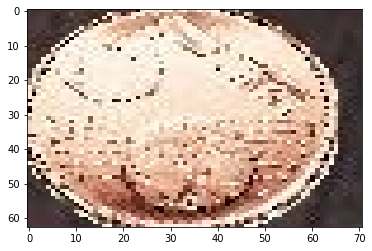

#########################
{'bounding_box': array([0.39200586, 0.7585878 , 0.4937743 , 0.82890123], dtype=float32), 'class_id': 0.0, 'score': 0.921875}
coin


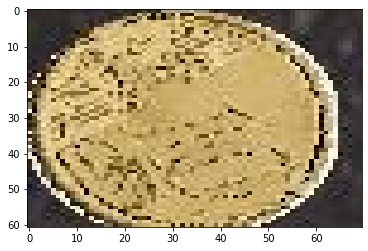

#########################
{'bounding_box': array([0.3332026 , 0.64964825, 0.43824798, 0.7199617 ], dtype=float32), 'class_id': 0.0, 'score': 0.921875}
coin


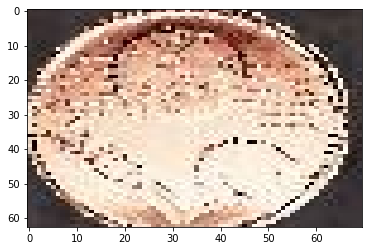

#########################
{'bounding_box': array([0.8585974 , 0.32013124, 0.97170484, 0.3958413 ], dtype=float32), 'class_id': 0.0, 'score': 0.91015625}
coin


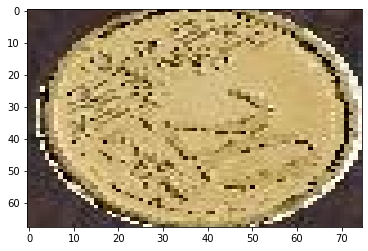

#########################
{'bounding_box': array([0.7947933 , 0.7166949 , 0.8998385 , 0.78700835], dtype=float32), 'class_id': 0.0, 'score': 0.890625}
coin


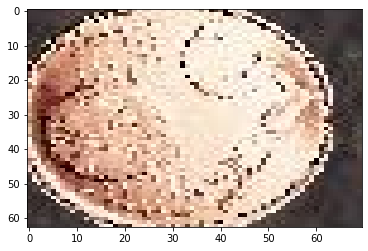

#########################
{'bounding_box': array([0.08723229, 0.85854065, 0.20398188, 0.9342506 ], dtype=float32), 'class_id': 0.0, 'score': 0.87890625}
coin


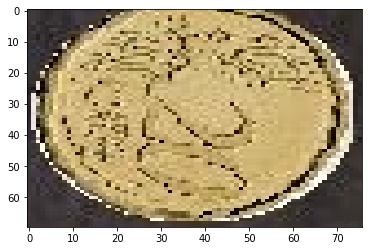

#########################
{'bounding_box': array([0.23898372, 0.7559586 , 0.3247514 , 0.8193521 ], dtype=float32), 'class_id': 0.0, 'score': 0.87890625}
coin


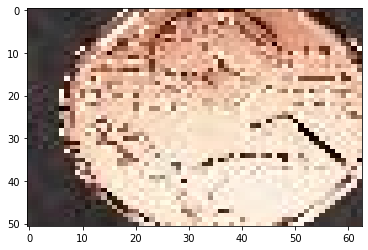

#########################
{'bounding_box': array([0.8600808 , 0.39642426, 0.93989724, 0.46599886], dtype=float32), 'class_id': 0.0, 'score': 0.83203125}
coin


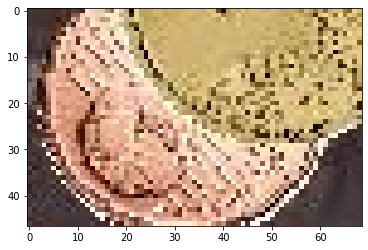

#########################
{'bounding_box': array([0.8360301 , 0.40237287, 0.91912234, 0.47135666], dtype=float32), 'class_id': 0.0, 'score': 0.6875}
coin


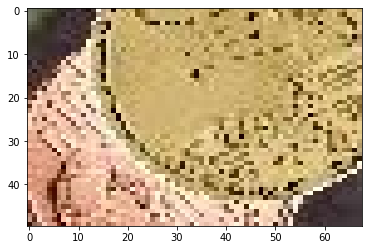

#########################
{'bounding_box': array([0.2839775 , 0.45724624, 0.3639024 , 0.51485103], dtype=float32), 'class_id': 0.0, 'score': 0.64453125}
coin


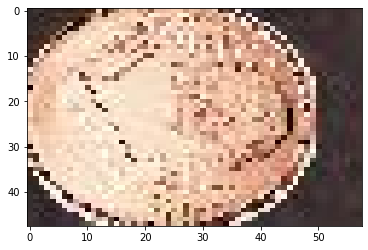

#########################


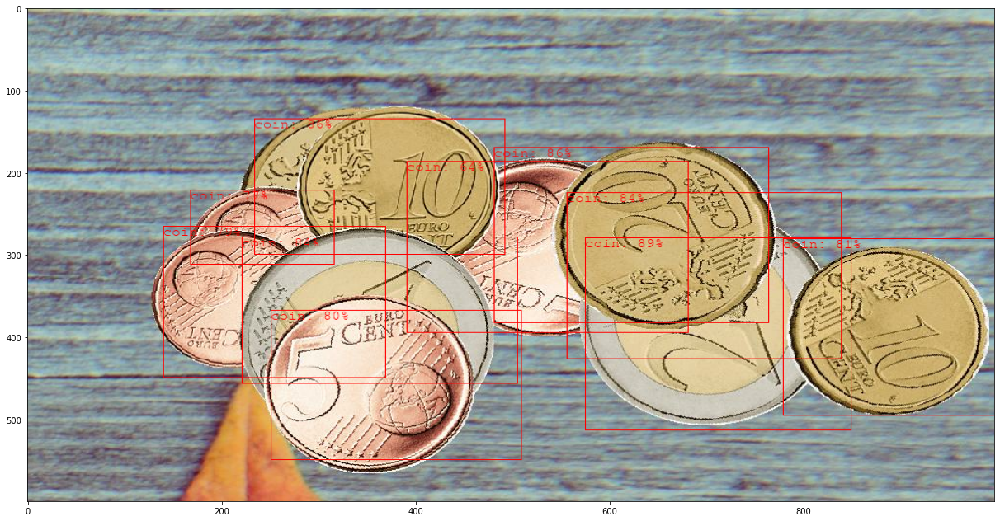

{'bounding_box': array([0.46548894, 0.5768184 , 0.85572004, 0.85219234], dtype=float32), 'class_id': 0.0, 'score': 0.890625}
coin


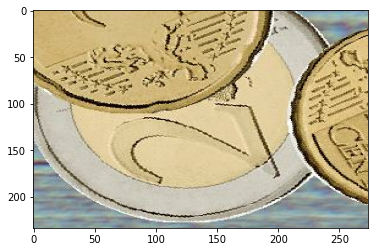

#########################
{'bounding_box': array([0.28327286, 0.48298943, 0.6381118 , 0.7672303 ], dtype=float32), 'class_id': 0.0, 'score': 0.86328125}
coin


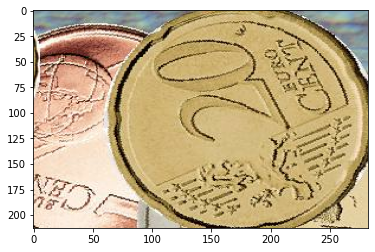

#########################
{'bounding_box': array([0.22348368, 0.23493016, 0.49923164, 0.4937426 ], dtype=float32), 'class_id': 0.0, 'score': 0.86328125}
coin


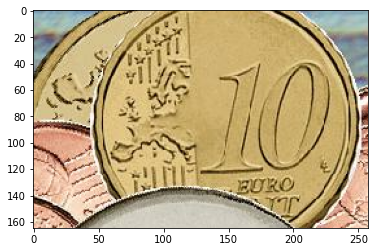

#########################
{'bounding_box': array([0.3746096 , 0.5580114 , 0.7111925 , 0.84225225], dtype=float32), 'class_id': 0.0, 'score': 0.83984375}
coin


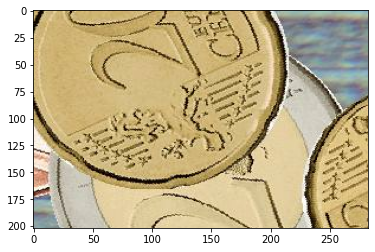

#########################
{'bounding_box': array([0.46439123, 0.22189632, 0.7613028 , 0.50652313], dtype=float32), 'class_id': 0.0, 'score': 0.83984375}
coin


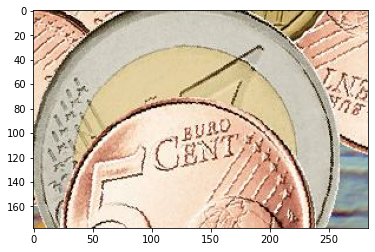

#########################
{'bounding_box': array([0.46712178, 0.781843  , 0.8254859 , 1.0079049 ], dtype=float32), 'class_id': 0.0, 'score': 0.8125}
coin


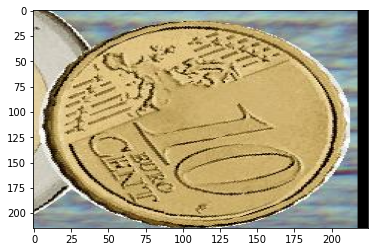

#########################
{'bounding_box': array([0.6126347 , 0.25191596, 0.9158861 , 0.5107285 ], dtype=float32), 'class_id': 0.0, 'score': 0.8046875}
coin


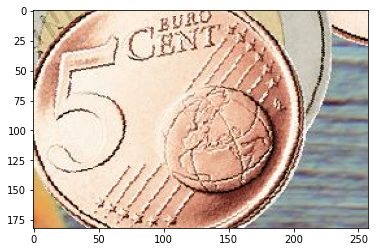

#########################
{'bounding_box': array([0.44249856, 0.1404945 , 0.7489705 , 0.37091383], dtype=float32), 'class_id': 0.0, 'score': 0.79296875}
coin


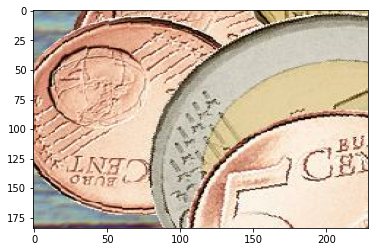

#########################
{'bounding_box': array([0.3697174 , 0.1687958 , 0.51954633, 0.31705028], dtype=float32), 'class_id': 0.0, 'score': 0.76953125}
coin


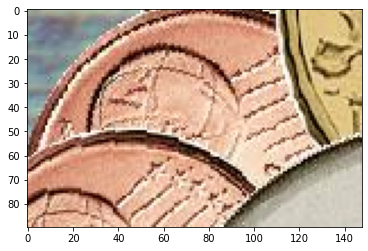

#########################
{'bounding_box': array([0.31153893, 0.39280435, 0.65825313, 0.6837059 ], dtype=float32), 'class_id': 0.0, 'score': 0.64453125}
coin


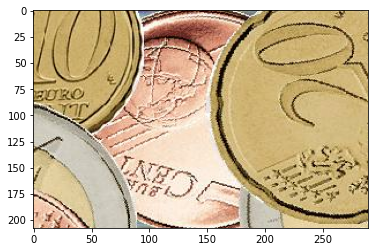

#########################


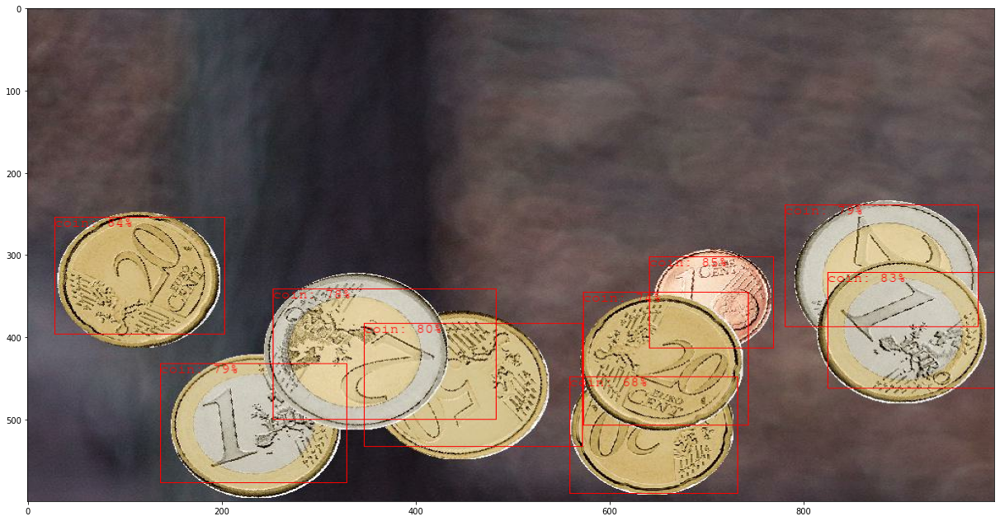

{'bounding_box': array([0.5045581 , 0.64379597, 0.6892588 , 0.77192926], dtype=float32), 'class_id': 0.0, 'score': 0.8515625}
coin


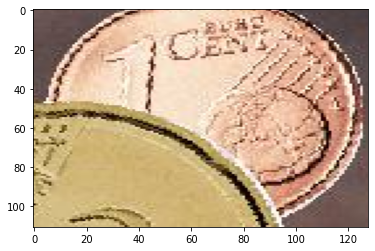

#########################
{'bounding_box': array([0.42467588, 0.02853912, 0.66033477, 0.20385616], dtype=float32), 'class_id': 0.0, 'score': 0.83984375}
coin


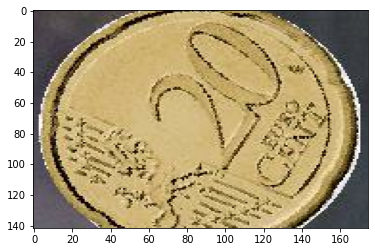

#########################
{'bounding_box': array([0.5358414 , 0.82783556, 0.7715003 , 1.0031526 ], dtype=float32), 'class_id': 0.0, 'score': 0.83203125}
coin


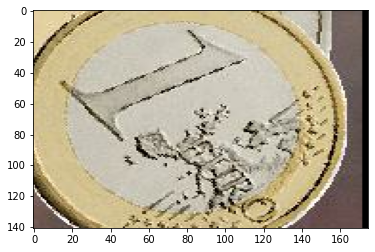

#########################
{'bounding_box': array([0.638891  , 0.34863257, 0.88962984, 0.5742346 ], dtype=float32), 'class_id': 0.0, 'score': 0.8046875}
coin


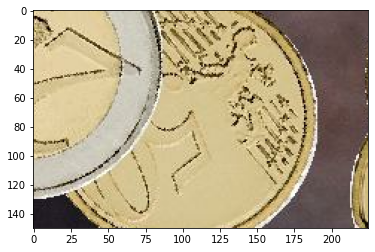

#########################
{'bounding_box': array([0.72145635, 0.13775241, 0.9621472 , 0.33055586], dtype=float32), 'class_id': 0.0, 'score': 0.79296875}
coin


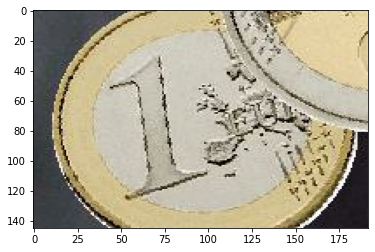

#########################
{'bounding_box': array([0.399217  , 0.7842966 , 0.6450472 , 0.98330814], dtype=float32), 'class_id': 0.0, 'score': 0.79296875}
coin


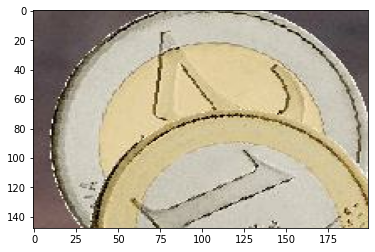

#########################
{'bounding_box': array([0.56921864, 0.2547042 , 0.83355737, 0.48512354], dtype=float32), 'class_id': 0.0, 'score': 0.77734375}
coin


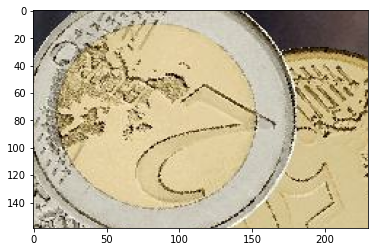

#########################
{'bounding_box': array([0.57522404, 0.5756749 , 0.8459408 , 0.74575365], dtype=float32), 'class_id': 0.0, 'score': 0.7421875}
coin


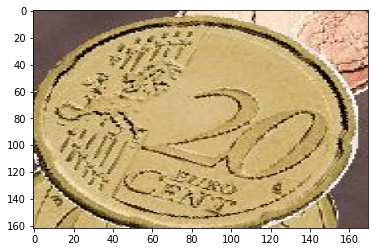

#########################
{'bounding_box': array([0.7480271 , 0.5612822 , 0.9840059 , 0.73499256], dtype=float32), 'class_id': 0.0, 'score': 0.67578125}
coin


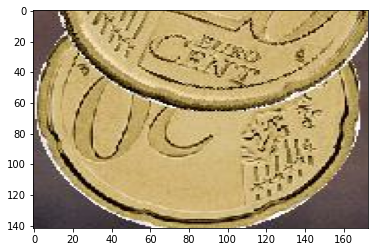

#########################


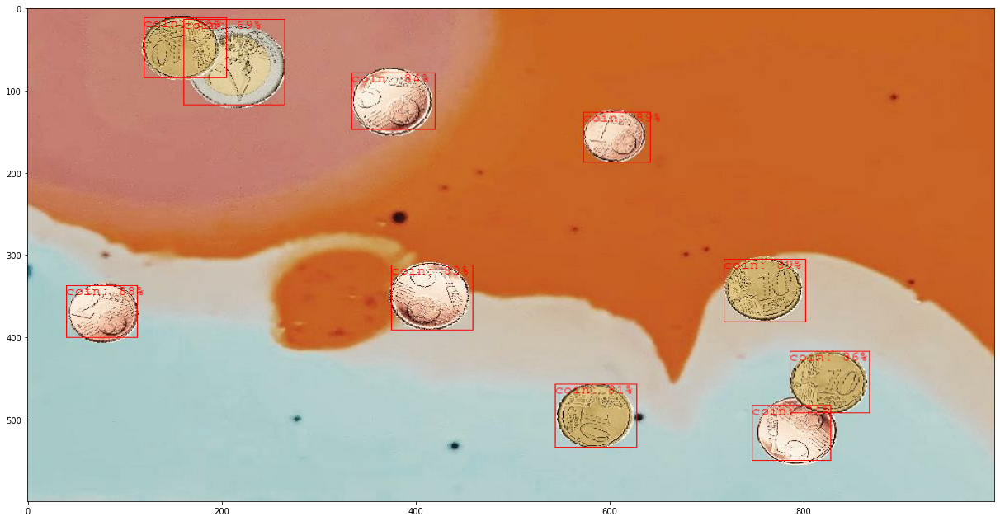

{'bounding_box': array([0.5095268 , 0.7204491 , 0.6352369 , 0.80459476], dtype=float32), 'class_id': 0.0, 'score': 0.890625}
coin


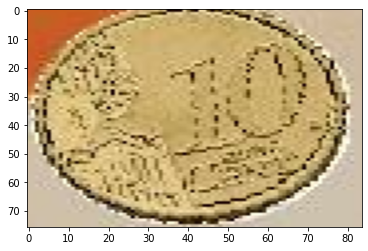

#########################
{'bounding_box': array([0.21019898, 0.5753613 , 0.31304827, 0.6442048 ], dtype=float32), 'class_id': 0.0, 'score': 0.88671875}
coin


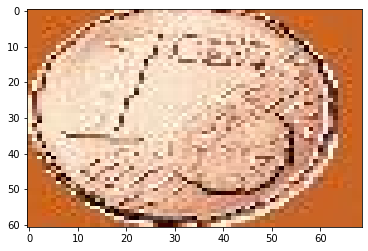

#########################
{'bounding_box': array([0.5618285, 0.0408183, 0.6677735, 0.1135437], dtype=float32), 'class_id': 0.0, 'score': 0.8828125}
coin


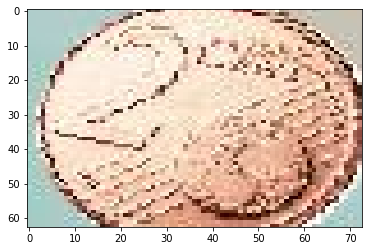

#########################
{'bounding_box': array([0.01856448, 0.12049301, 0.14035311, 0.20643546], dtype=float32), 'class_id': 0.0, 'score': 0.86328125}
coin


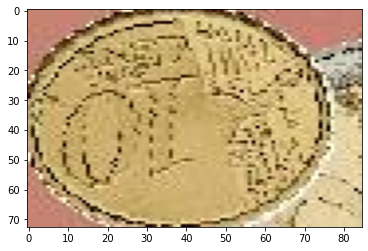

#########################
{'bounding_box': array([0.69583565, 0.7891639 , 0.8202247 , 0.8715504 ], dtype=float32), 'class_id': 0.0, 'score': 0.86328125}
coin


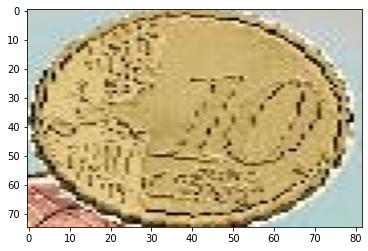

#########################
{'bounding_box': array([0.1308226 , 0.3354826 , 0.24618867, 0.42130852], dtype=float32), 'class_id': 0.0, 'score': 0.84375}
coin


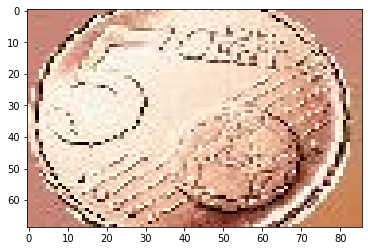

#########################
{'bounding_box': array([0.5203812 , 0.37667164, 0.65290976, 0.46081737], dtype=float32), 'class_id': 0.0, 'score': 0.83203125}
coin


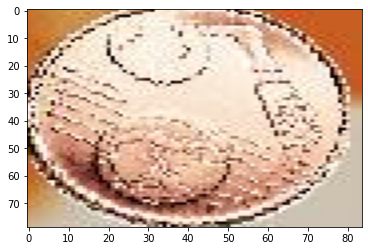

#########################
{'bounding_box': array([0.7625666 , 0.5463694 , 0.8909609 , 0.63051504], dtype=float32), 'class_id': 0.0, 'score': 0.8125}
coin


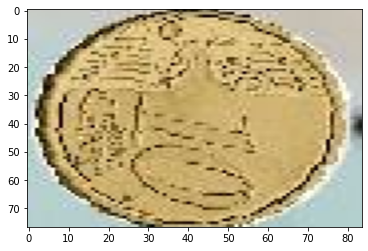

#########################
{'bounding_box': array([0.80553424, 0.74928415, 0.9173014 , 0.83069444], dtype=float32), 'class_id': 0.0, 'score': 0.7421875}
coin


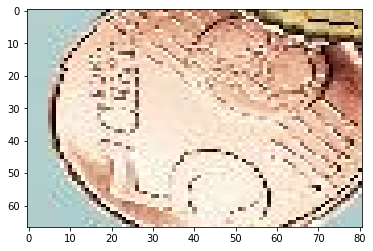

#########################
{'bounding_box': array([0.02206997, 0.16205685, 0.19566244, 0.26592785], dtype=float32), 'class_id': 0.0, 'score': 0.6875}
coin


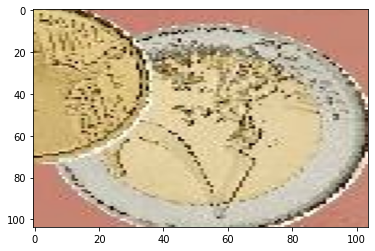

#########################


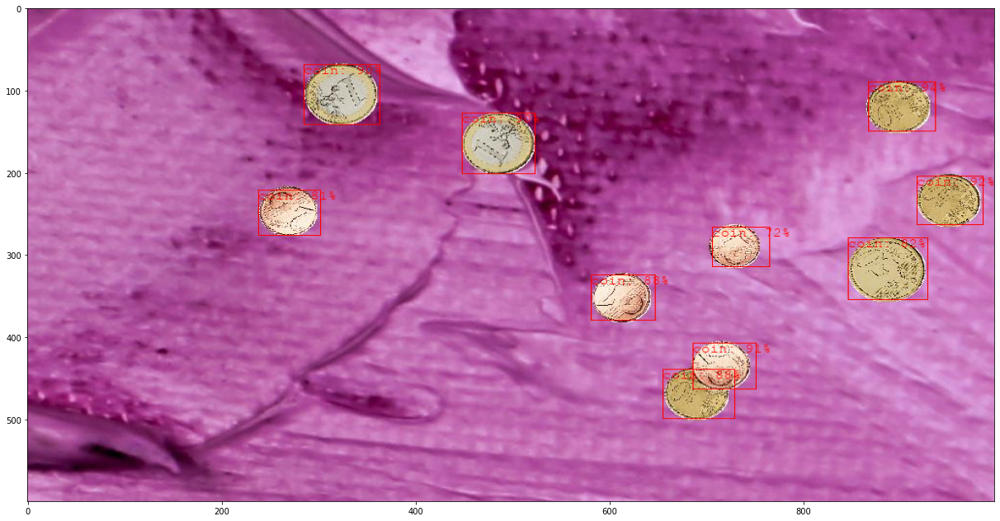

{'bounding_box': array([0.14871916, 0.870059  , 0.24941823, 0.9389025 ], dtype=float32), 'class_id': 0.0, 'score': 0.94140625}
coin


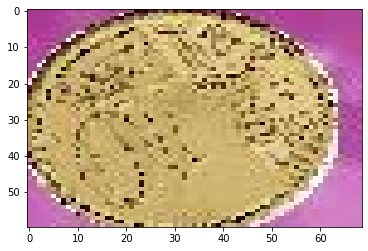

#########################
{'bounding_box': array([0.34092012, 0.92003703, 0.43951395, 0.9888805 ], dtype=float32), 'class_id': 0.0, 'score': 0.91796875}
coin


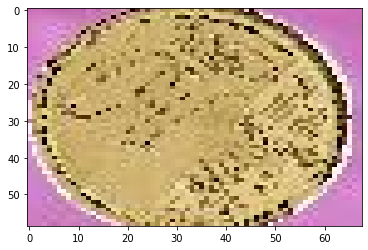

#########################
{'bounding_box': array([0.6786521, 0.6887668, 0.7731665, 0.7540683], dtype=float32), 'class_id': 0.0, 'score': 0.91015625}
coin


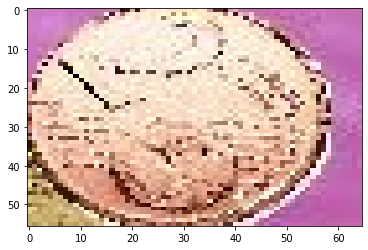

#########################
{'bounding_box': array([0.21254967, 0.4500208 , 0.33563167, 0.52493525], dtype=float32), 'class_id': 0.0, 'score': 0.8984375}
coin


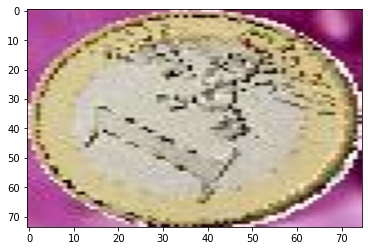

#########################
{'bounding_box': array([0.11477855, 0.28679144, 0.23528737, 0.36493933], dtype=float32), 'class_id': 0.0, 'score': 0.8984375}
coin


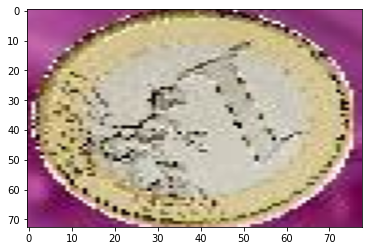

#########################
{'bounding_box': array([0.7323554 , 0.6576232 , 0.83199626, 0.73175037], dtype=float32), 'class_id': 0.0, 'score': 0.87890625}
coin


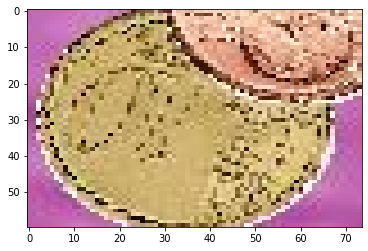

#########################
{'bounding_box': array([0.5413435 , 0.5830739 , 0.63194746, 0.649069  ], dtype=float32), 'class_id': 0.0, 'score': 0.875}
coin


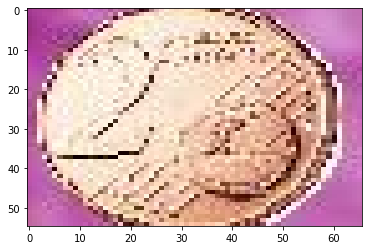

#########################
{'bounding_box': array([0.46532896, 0.8490036 , 0.5907834 , 0.93155795], dtype=float32), 'class_id': 0.0, 'score': 0.8203125}
coin


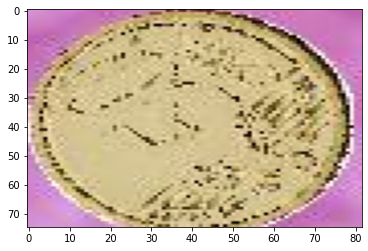

#########################
{'bounding_box': array([0.36936805, 0.23908797, 0.4609342 , 0.30370334], dtype=float32), 'class_id': 0.0, 'score': 0.8125}
coin


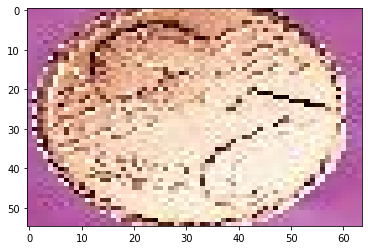

#########################
{'bounding_box': array([0.44352272, 0.7084578 , 0.5242964 , 0.7679175 ], dtype=float32), 'class_id': 0.0, 'score': 0.72265625}
coin


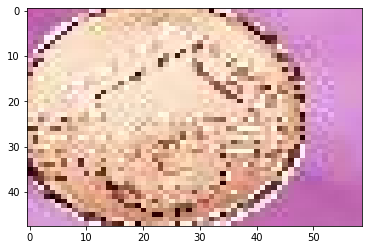

#########################


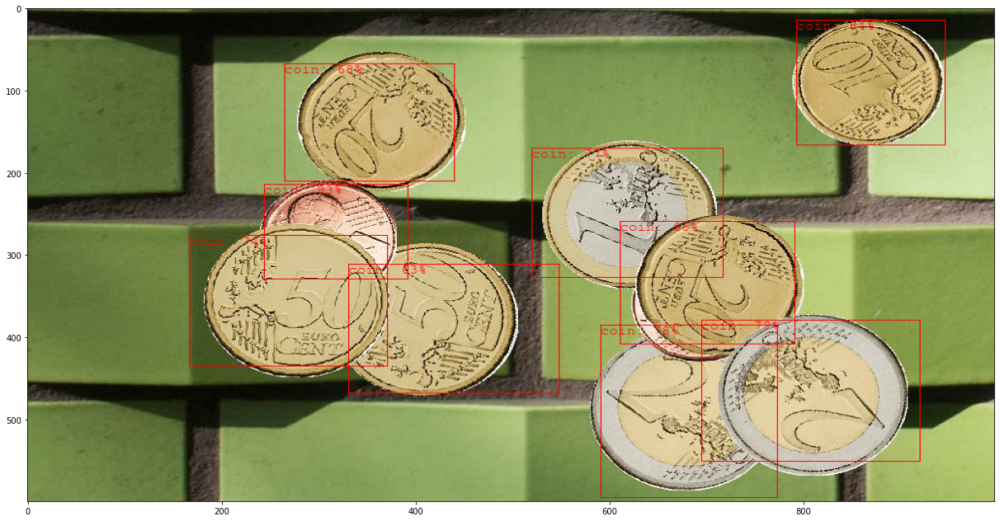

{'bounding_box': array([0.3580971 , 0.24561444, 0.54913354, 0.39386895], dtype=float32), 'class_id': 0.0, 'score': 0.93359375}
coin


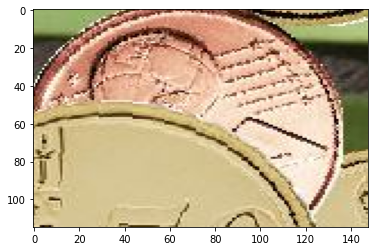

#########################
{'bounding_box': array([0.02376381, 0.7957891 , 0.27733746, 0.9491291 ], dtype=float32), 'class_id': 0.0, 'score': 0.83984375}
coin


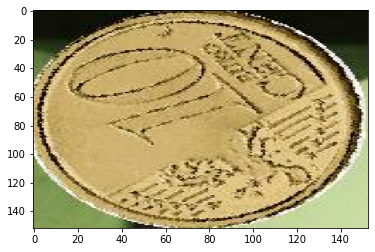

#########################
{'bounding_box': array([0.63197064, 0.6972192 , 0.91962004, 0.9228212 ], dtype=float32), 'class_id': 0.0, 'score': 0.79296875}
coin


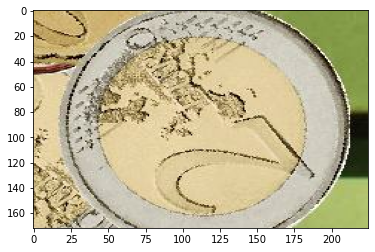

#########################
{'bounding_box': array([0.6419591 , 0.5931176 , 0.9928311 , 0.77612567], dtype=float32), 'class_id': 0.0, 'score': 0.77734375}
coin


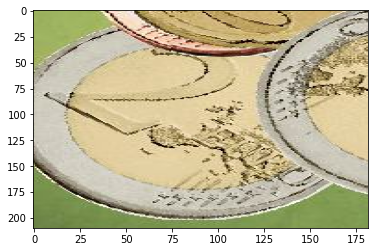

#########################
{'bounding_box': array([0.284536  , 0.5222649 , 0.54645216, 0.7191852 ], dtype=float32), 'class_id': 0.0, 'score': 0.76953125}
coin


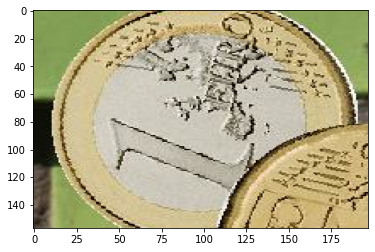

#########################
{'bounding_box': array([0.46121183, 0.16766346, 0.7259096 , 0.37308306], dtype=float32), 'class_id': 0.0, 'score': 0.7421875}
coin


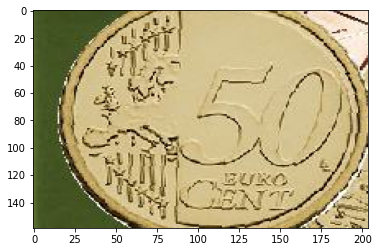

#########################
{'bounding_box': array([0.11280965, 0.26671582, 0.35097122, 0.4420328 ], dtype=float32), 'class_id': 0.0, 'score': 0.67578125}
coin


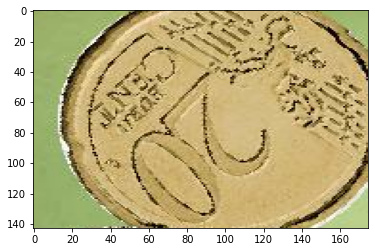

#########################
{'bounding_box': array([0.43186706, 0.61299103, 0.6803079 , 0.7939531 ], dtype=float32), 'class_id': 0.0, 'score': 0.65625}
coin


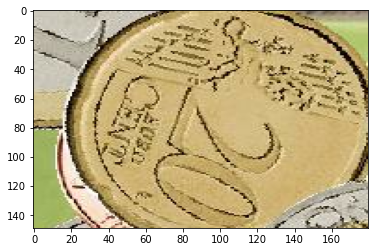

#########################
{'bounding_box': array([0.5191435 , 0.33206022, 0.78070456, 0.55062467], dtype=float32), 'class_id': 0.0, 'score': 0.6328125}
coin


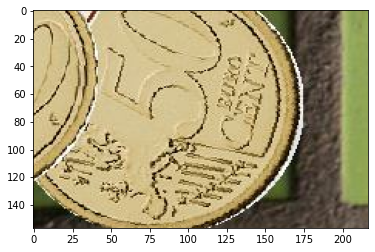

#########################


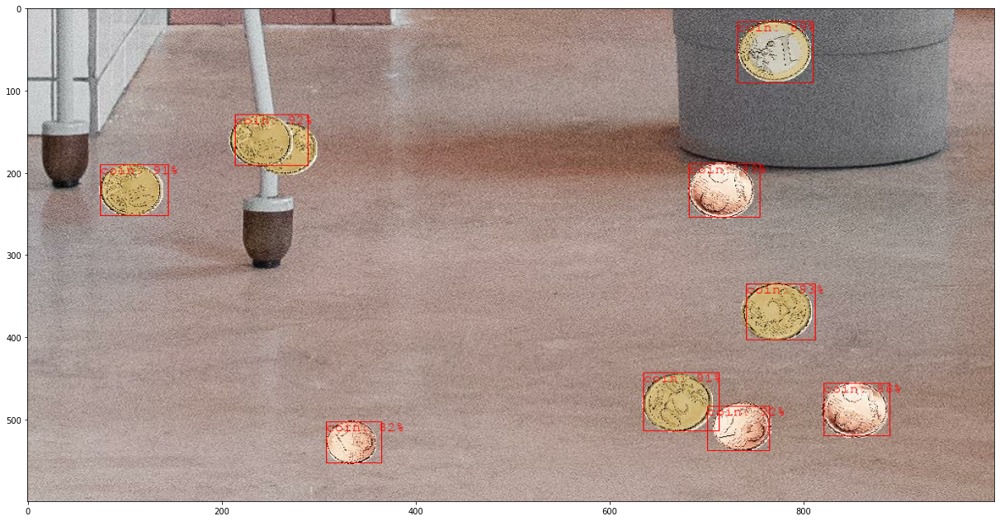

{'bounding_box': array([0.5590333 , 0.74334604, 0.67310965, 0.8153072 ], dtype=float32), 'class_id': 0.0, 'score': 0.92578125}
coin


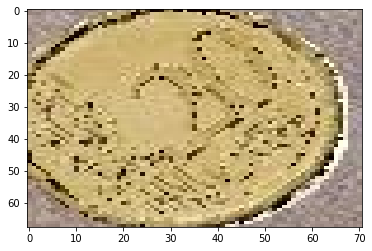

#########################
{'bounding_box': array([0.80729085, 0.7039563 , 0.8967604 , 0.76802295], dtype=float32), 'class_id': 0.0, 'score': 0.921875}
coin


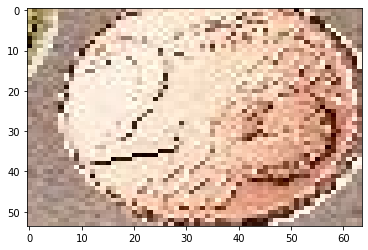

#########################
{'bounding_box': array([0.21583149, 0.21529272, 0.319773  , 0.29020718], dtype=float32), 'class_id': 0.0, 'score': 0.91796875}
coin


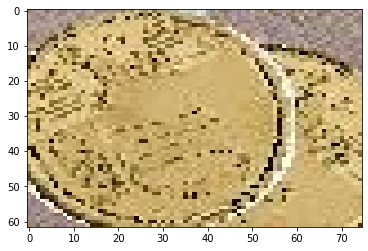

#########################
{'bounding_box': array([0.3167957 , 0.07589404, 0.4207372 , 0.14546865], dtype=float32), 'class_id': 0.0, 'score': 0.90625}
coin


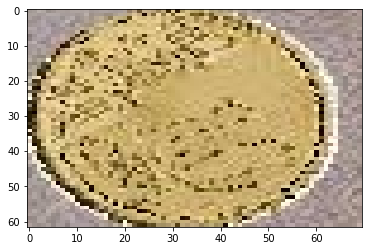

#########################
{'bounding_box': array([0.7389542 , 0.63788825, 0.85795426, 0.7153725 ], dtype=float32), 'class_id': 0.0, 'score': 0.90625}
coin


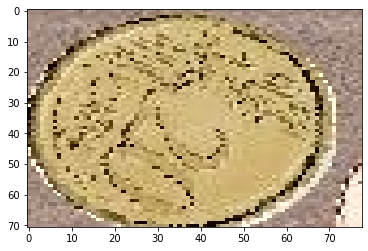

#########################
{'bounding_box': array([0.31634927, 0.6847434 , 0.42477703, 0.7580917 ], dtype=float32), 'class_id': 0.0, 'score': 0.88671875}
coin


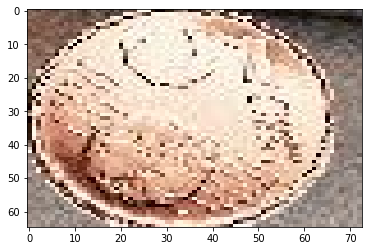

#########################
{'bounding_box': array([0.02779961, 0.7350168 , 0.15088162, 0.8131646 ], dtype=float32), 'class_id': 0.0, 'score': 0.88671875}
coin


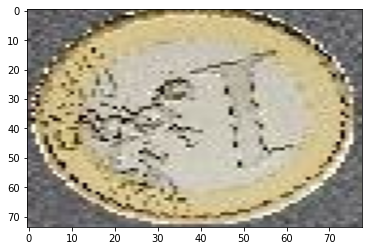

#########################
{'bounding_box': array([0.7606526 , 0.8235646 , 0.86794084, 0.8924081 ], dtype=float32), 'class_id': 0.0, 'score': 0.86328125}
coin


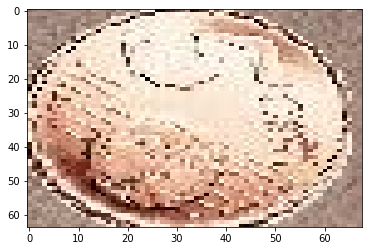

#########################
{'bounding_box': array([0.83982724, 0.30939794, 0.9223257 , 0.36700273], dtype=float32), 'class_id': 0.0, 'score': 0.8203125}
coin


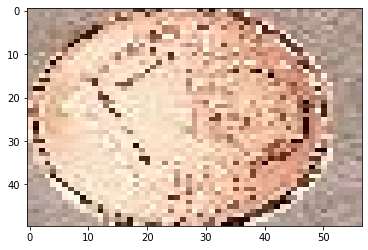

#########################


In [43]:
DETECTION_THRESHOLD = 0.6

# Load the TFLite model
interpreter = tf.lite.Interpreter(model_path=model_path)
interpreter.allocate_tensors()

for test_file in data[data[0]=='TEST'][1].unique():
    # Run inference and draw detection result on the local copy of the original file
    detection_result_image, results, detected_coins = run_odt_and_draw_results(
        test_file,
        interpreter,
        threshold=DETECTION_THRESHOLD,
        draw=True
    )
    # Show the detection result
    plt.figure(figsize = (21,11))
    plt.imshow(np.asarray(detection_result_image), aspect="auto")
    detection_result_image
    plt.show()
    
    for res, img in zip(results, detected_coins):
        print(res)
        print(classes[int(res["class_id"])])
        plt.imshow(np.asarray(img), aspect="auto")
        plt.show()
        print("#"*25)
